In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import glob
#Install python certificates
import ssl
ssl._create_default_https_context = ssl._create_unverified_context
import re
import seaborn as sns
from math import radians, sin, cos, asin, sqrt
import imageio
import os
from IPython.display import Image, display
import time
from scipy.stats import gaussian_kde
from statistics import mean
import statistics
import random

plotdir = 'plots/'

In [3]:
dispersal = np.load("data/SGDP_v1_annot_ne_100M_NonetCutoff_mle-dispersal.npy")
print([round(i,2) for i in dispersal])

[2.0, 0.67, 0.1, 0.0]


In [4]:
ids = []
groups = []
with open('data/SGDP.poplabels',"rb") as f:
    next(f) #skip header
    for line in f:
        ids.append(line.strip().split(b' ')[0])
        groups.append(line.strip().split(b' ')[2])
    groups = [entry.decode('utf-8') for entry in groups]
    groups = [item for item in groups for _ in range(2)]
        
metadata = []
with open('data/SGDP_metadata.279public.21signedLetter.samples.txt','rb') as file:
    next(file) #skip header
    for line in file:
        metadata.append(line.strip().split(b'\t'))

accessions = [i[4] for i in metadata]


order = []
for id in ids:
    ix = accessions.index(id)
    order.append(ix)
print(len(ids))

locations = np.load('data/SGDP_locations.npy')
locations = np.repeat(locations,2,axis=0)
#print(len(locations))

group = np.array([i[5] for i in metadata])[order]
population_names, population_ixs = np.unique(group, return_inverse=True)
#print(population_names,population_ixs)


278


In [5]:
#m = '1.25e-8'
Ms = 100
CHR = 18
tCutoff = 'None'
samples = range(556)


10000+generation samples loading

In [6]:
fnss_10000 = []

for sample in samples:
    string = 'data/SGDP_v1_annot_ne_chr18' + '_*bps_%dM_10000+_generation_%stCutoff_anc-locs_full-trees_%dsample.npy'%(Ms, tCutoff,sample)
    fns = [fn for fn in sorted(glob.iglob(string))]

    starts = [int(re.search('chr18_(.+?)-', fn).group(1)) for fn in fns]
    locus_order = np.argsort(starts)
    
    fnss_10000.append([fns[i] for i in locus_order])


In [7]:
anc_locs_10000 = []
for i,fns in enumerate(fnss_10000):
    anc_loc = [np.squeeze(np.load(fn)) for fn in fns]    
    anc_locs_10000.append(anc_loc)

anc_locs_10000 = np.array(anc_locs_10000)

anc_locs_10000 = np.swapaxes(anc_locs_10000,0,1)
anc_locs_10000 = anc_locs_10000[:, :, 1:, :]
L, n, T, d = anc_locs_10000.shape
L, n, T, d #T=11 cuz include time 0


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (556,) + inhomogeneous part.

samples loading

In [8]:
fnss_0 = []

for sample in samples:
    string = 'data/SGDP_v1_annot_ne_chr18' + '_*bps_%dM_%stCutoff_anc-locs_full-trees_%dsample.npy'%(Ms, tCutoff,sample)
    fns = [fn for fn in sorted(glob.iglob(string))]

    starts = [int(re.search('chr18_(.+?)-', fn).group(1)) for fn in fns]
    locus_order = np.argsort(starts)
    
    fnss_0.append([fns[i] for i in locus_order])
    
#fns = [fn for fns in fnss for fn in fns]


In [9]:
# Check if all elements are lists and have the same length
is_matrix = isinstance(fnss_0, list) and all(isinstance(row, list) for row in fnss_0) and all(len(row) == len(fnss_0[0]) for row in fnss_0)
print(is_matrix)
num_rows = len(fnss_0) if isinstance(fnss_0, list) else 0

# Check the number of columns (length of the first inner list)
num_cols = len(fnss_0[0]) if num_rows > 0 and isinstance(fnss_0[0], list) else 0

print(num_rows, num_cols) 


False
556 42


In [10]:
# Combine two time ranges
anc_locs_0 = []
for i,fns in enumerate(fnss_0):
    anc_loc = [np.squeeze(np.load(fn)) for fn in fns]
    anc_locs_0.append(anc_loc)
    #print(anc_locs_0)

anc_locs_0 = np.array(anc_locs_0)

anc_locs_0 = np.swapaxes(anc_locs_0,0,1)
L, n, T, d = anc_locs_0.shape
L, n, T, d

FileNotFoundError: [Errno 2] No such file or directory: 'data/SGDP_v1_annot_ne_chr18_2576563-2579304bps_100M_NonetCutoff_anc-locs_full-trees_52sample.npy'

In [10]:
anc_locs = np.concatenate((anc_locs_0,anc_locs_10000),axis=2)
L, n, T, d = anc_locs.shape
L, n, T, d #T=11 cuz include time 0

(42, 556, 15, 2)

In [83]:
ancestor_times1 = np.logspace(1,np.log10(1e4),10)
print(ancestor_times1)
ancestor_times1 = np.append([0],ancestor_times1)
ancestor_times1 = np.array([round(i) for i in ancestor_times1])
print(ancestor_times1)
ancestor_times2 = np.array([round(i) for i in np.logspace(np.log10(1e4),np.log10(1e5),5)[1:]])
print(ancestor_times2)
ancestor_times = np.hstack((ancestor_times1,ancestor_times2))[:-2]

#ancestor_times=ancestor_times[:-2]
print(ancestor_times)
print(len(ancestor_times))

[   10.            21.5443469     46.41588834   100.
   215.443469     464.15888336  1000.          2154.43469003
  4641.58883361 10000.        ]
[    0    10    22    46   100   215   464  1000  2154  4642 10000]
[ 17783  31623  56234 100000]
[    0    10    22    46   100   215   464  1000  2154  4642 10000 17783
 31623]
13


projected samples loading

In [154]:
'''selected_samples = []

# Add 5 samples from "America"
america_samples = [i for i,sample in enumerate(groups) if sample == "America"]
selected_samples.extend(random.sample(america_samples, 5))

# Add 1 sample from each of the other groups
for group in unique_strings:
    if group != "America":
        group_samples = [i for i,sample in enumerate(groups) if sample == group]
        selected_samples.extend(random.sample(group_samples, 1))
print(selected_samples)
[new_locations[i] for i in selected_samples]'''

selected_samples = [112, 550, 98, 96, 102, 44, 483, 192, 267, 377, 433,62,40,236,410]
[new_locations[i] for i in selected_samples]

[array([143. , -13.5]),
 array([152., -10.]),
 array([124.,  19.]),
 array([124.,  19.]),
 array([118.42,  16.95]),
 array([-109.8,   -1.5]),
 array([-70.4,  42.9]),
 array([-63.5,  43.5]),
 array([-2., -4.]),
 array([-70.7,  31.5]),
 array([-125.9,   47.5]),
 array([-157.,   12.]),
 array([-108.,   -3.]),
 array([-44.5,  13.8]),
 array([-118. ,   69.9])]

In [13]:
# Projection to Pacific center
proj = 145
new_locations = []
for i,lon in enumerate(locations[:,0]):
    new_lon = lon-proj
    if new_lon < -180:
        new_lon += 360
    new_locations.append([new_lon,locations[i,1]])
new_locations = np.array(new_locations)
np.save("data/SGDP_new_locations.npy",new_locations)
print(locations)
print(new_locations)


[[  3.          32.        ]
 [  3.          32.        ]
 [  3.          32.        ]
 ...
 [-96.58        16.95      ]
 [ 27.4          8.78333333]
 [ 27.4          8.78333333]]
[[-142.           32.        ]
 [-142.           32.        ]
 [-142.           32.        ]
 ...
 [ 118.42         16.95      ]
 [-117.6           8.78333333]
 [-117.6           8.78333333]]


In [14]:
fnss_proj = []
print(selected_samples)
for sample in selected_samples:
    string = 'data/SGDP_v1_annot_ne_chr18' + '_*bps_%dM_%stCutoff_projected_anc-locs_full-trees_%dsample.npy'%(Ms, tCutoff,sample)
    fns = [fn for fn in sorted(glob.iglob(string))]

    starts = [int(re.search('chr18_(.+?)-', fn).group(1)) for fn in fns]
    locus_order = np.argsort(starts)
    
    fnss_proj.append([fns[i] for i in locus_order])

NameError: name 'selected_samples' is not defined

In [156]:
# Check if all elements are lists and have the same length
is_matrix = isinstance(fnss_proj, list) and all(isinstance(row, list) for row in fnss_proj) and all(len(row) == len(fnss_proj[0]) for row in fnss_proj)
print(is_matrix)
num_rows = len(fnss_proj) if isinstance(fnss_proj, list) else 0

# Check the number of columns (length of the first inner list)
num_cols = len(fnss_proj[0]) if num_rows > 0 and isinstance(fnss_proj[0], list) else 0

print(num_rows, num_cols) 


True
15 42


In [157]:
anc_locs_proj = []
for i,fns in enumerate(fnss_proj):
    anc_loc = [np.squeeze(np.load(fn)) for fn in fns]    
    anc_locs_proj.append(anc_loc)

anc_locs_proj = np.array(anc_locs_proj)

anc_locs_proj = np.swapaxes(anc_locs_proj,0,1)
anc_locs_proj = anc_locs_proj[:, :, 1:, :]
L, n, T, d = anc_locs_proj.shape
L, n, T, d #T=11 cuz include time 0

print(anc_locs_proj[0][0])

[[141.34303419 -12.72191466]
 [139.43012895 -11.82369342]
 [135.30952144  -9.88852062]
 [126.43010627  -5.71920063]
 [107.30236548   3.26276783]
 [ 66.09420147  22.61532603]
 [ 17.46291083  20.03706195]
 [-47.34178413  11.20464919]
 [-70.57256171   5.43364354]
 [-82.52326044   9.05841309]
 [-85.66733812  14.13568628]
 [-47.02083808  13.91062641]]


# Sample locations (by groups)

Group define

In [104]:
unique_strings = list(dict.fromkeys(groups))
string_to_number = {string: i for i, string in enumerate(unique_strings)}
groups_num = [string_to_number[string] for string in groups]
print(groups_num)

cmap = matplotlib.colormaps.get_cmap('Set1')
group_colors = {string: cmap(string_to_number[string]) for string in groups}

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 

In [105]:
selected_samples = []

# Add 5 samples from "America"
america_samples = [i for i,sample in enumerate(groups) if sample == "America"]
selected_samples.extend(random.sample(america_samples, 5))

# Add 1 sample from each of the other groups
for group in unique_strings:
    if group != "America":
        group_samples = [i for i,sample in enumerate(groups) if sample == group]
        selected_samples.extend(random.sample(group_samples, 1))
print(selected_samples)

[112, 550, 98, 96, 102, 44, 483, 192, 267, 377, 433]


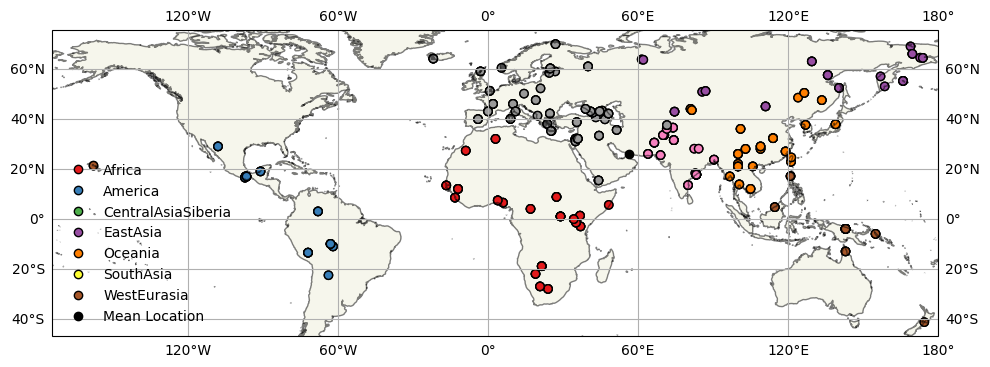

In [97]:
#old map
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection=ccrs.PlateCarree())
cmap = matplotlib.colormaps.get_cmap('Set1')

ax.scatter(locations[:,0], locations[:,1], transform=ccrs.PlateCarree(), c=groups_num, cmap=cmap, edgecolor='k', zorder=1) #add group c
ax.plot(mean(locations[:,0]),mean(locations[:,1]),'o',c="black", zorder=2)

ax.coastlines(resolution='50m', alpha=0.5)
ax.add_feature(cfeature.LAND, alpha=0.5)
handles = [plt.Line2D((0,1),(0,0), color=cmap(i), marker='o', linestyle='', markeredgecolor='k') for i in set(groups_num)]
mean_handle = plt.Line2D([], [], color='black', marker='o', linestyle='', markeredgecolor='k')
handles.append(mean_handle)
legend_labels = list(unique_strings) + ['Mean Location']
plt.legend(handles, legend_labels, loc='lower left', frameon=False)

gl = ax.gridlines(draw_labels=True, crs=ccrs.PlateCarree())
gl.xlabels_top = False
gl.ylabels_right = False

plt.tight_layout()
plt.savefig(plotdir + 'locations.pdf')
plt.show()
extent = ax.get_extent(crs=ccrs.PlateCarree())


[56.49740120733813, 26.011298514255397]


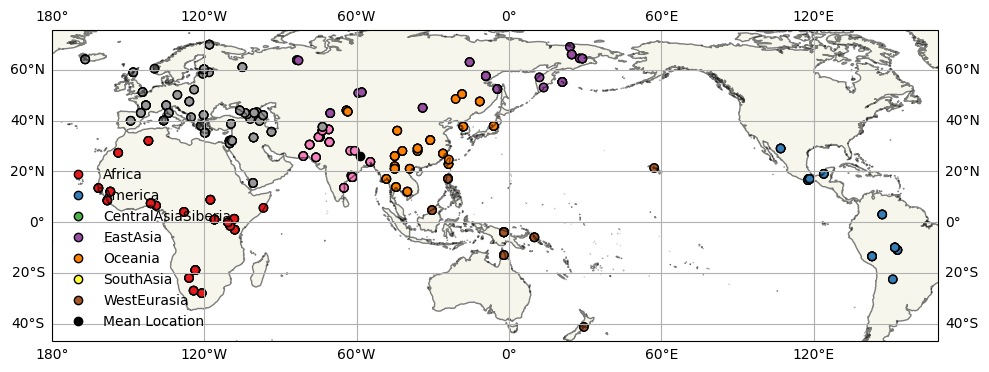

In [99]:
#new projection
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection=ccrs.PlateCarree(central_longitude=+145))
cmap = matplotlib.colormaps.get_cmap('Set1')

ax.scatter(new_locations[:,0], new_locations[:,1], c=groups_num, cmap=cmap, edgecolor='k', zorder=1) #add group c
#ax.plot(mean(new_locations[:,0]),mean(new_locations[:,1]),'o',c="black", zorder=2)

ax.coastlines(resolution='50m', alpha=0.5)
ax.add_feature(cfeature.LAND, alpha=0.5)
handles = [plt.Line2D((0,1),(0,0), color=cmap(i), marker='o', linestyle='', markeredgecolor='k') for i in set(groups_num)]
mean_handle = plt.Line2D([], [], color='black', marker='o', linestyle='', markeredgecolor='k')
handles.append(mean_handle)
legend_labels = list(unique_strings) + ['Mean Location']
plt.legend(handles, legend_labels, loc='lower left', frameon=False)

gl = ax.gridlines(draw_labels=True, crs=ccrs.PlateCarree(central_longitude=+145))
gl.xlabels_top = False
gl.ylabels_right = False

plt.tight_layout()
plt.savefig(plotdir + 'locations.pdf')
plt.show()
extent = ax.get_extent(crs=ccrs.PlateCarree())


# Mean displacements

In [18]:
def haversine(loc1, loc2):
    """
    Calculate the great circle distance between two points 
    on the earth time_ix = 1 #choose which time to get ancestor locations at

disps = []
for sample in range(n):

    locs = anc_locs[:,sample,time_ix]
    #print(locs)
#     row_mask = (locs != locations[sample]).all(axis=1)
#     locs = locs[row_mask,:] #exclude subtrees that contain only the sample
    mean_loc = np.mean(locs, axis=0)
    #print(mean_loc,locations[sample])
    disp = mean_loc - locations[sample]
    disps.append(disp)(specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [loc1[0], loc1[1], loc2[0], loc2[1]])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

## Null mean displacement

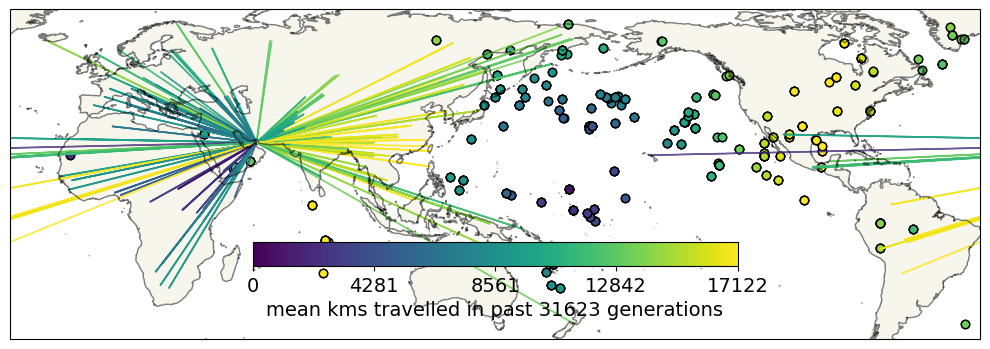

Time taken to execute the code: 10.4339 seconds


In [19]:
start_time = time.time() #timer

time_ix = -1
disps = []
mean_lonlat = [np.mean(locations[:,0]),np.mean(locations[:,1])]
for sample in range(n): #for all samples
    disp = mean_lonlat - locations[sample]
    disps.append(disp)

    dists = [haversine(locations[i], disp) for i,disp in enumerate(disps)]
    relative_dists = dists/np.max(dists)
    np.mean(dists)
        
fig = plt.figure(figsize=(10, 10))

ax = fig.add_subplot(projection=ccrs.PlateCarree())

for i,disp in enumerate(disps):

    cmap = plt.get_cmap('viridis')
    color = cmap(relative_dists[i])
        #     color = plt.cm.tab10(population_ixs[i])
    ax.scatter(locations[i,0], locations[i,1], color=color, edgecolor='k', zorder=0)
    ax.arrow(locations[i,0], locations[i,1], disp[0], disp[1], transform=ccrs.PlateCarree(),
            head_width=0.5, length_includes_head=True, width=0.1, alpha=0.5, color=color)
            #ax.annotate(str(i), xy=(locations[i, 0], locations[i, 1]), xytext=(3, 3), textcoords='offset points', 
                        #ha='right', fontsize=8, transform=ccrs.PlateCarree())

ax.coastlines(resolution='50m', alpha=0.5)
ax.add_feature(cfeature.LAND, alpha=0.5)

cbar = fig.colorbar(plt.cm.ScalarMappable(norm=None, cmap=cmap), ax=ax, orientation='horizontal', pad=-0.1, shrink=0.5)
cbar.set_ticks([i/4 for i in range(5)])
cbar.set_ticklabels([round(i*max(dists)/4) for i in range(5)])
cbar.set_label('mean kms travelled in past %d generations' %int(ancestor_times[time_ix]), fontsize=14)
cbar.ax.tick_params(labelsize=14)

plt.tight_layout()
filename = f'time_ixs_null.png' 
plt.savefig(os.path.join(plotdir, filename))

plt.show()

plt.close()

end_time = time.time()
elapsed_time = end_time - start_time
print(f"Time taken to execute the code: {elapsed_time:.4f} seconds")


## By distances

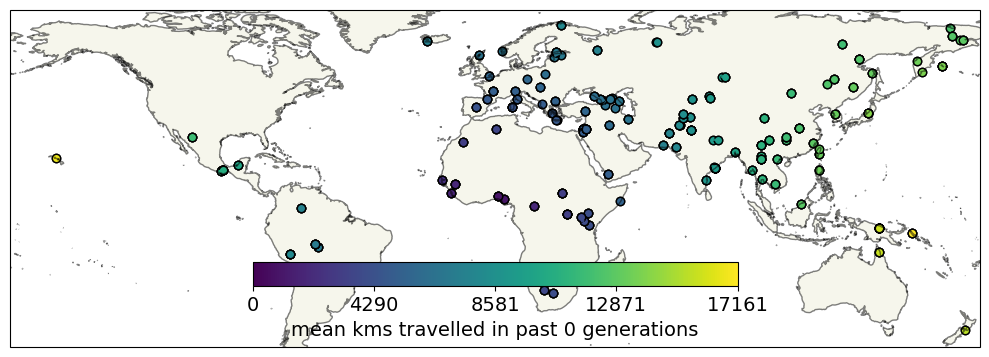

Time taken to execute the code: 10.6158 seconds


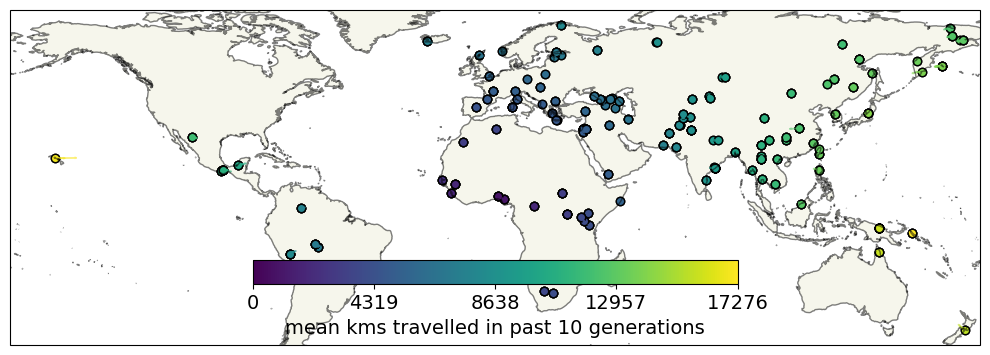

Time taken to execute the code: 11.3224 seconds


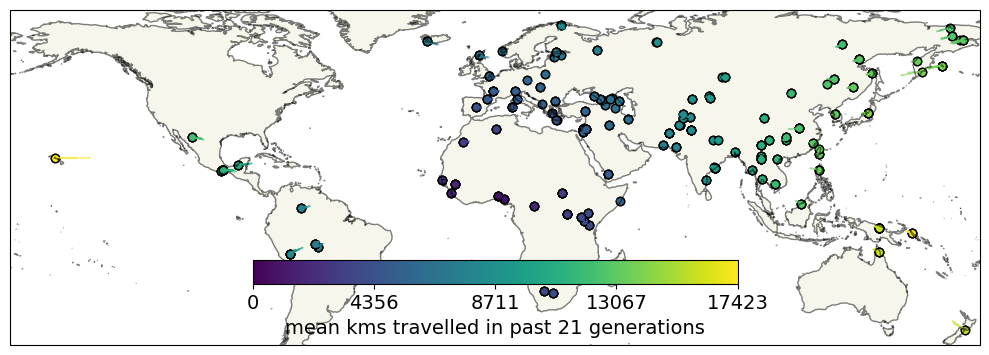

Time taken to execute the code: 10.7420 seconds


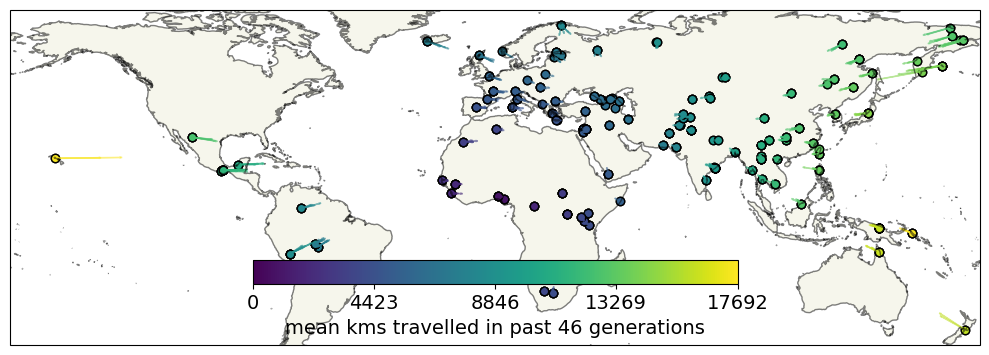

Time taken to execute the code: 11.2183 seconds


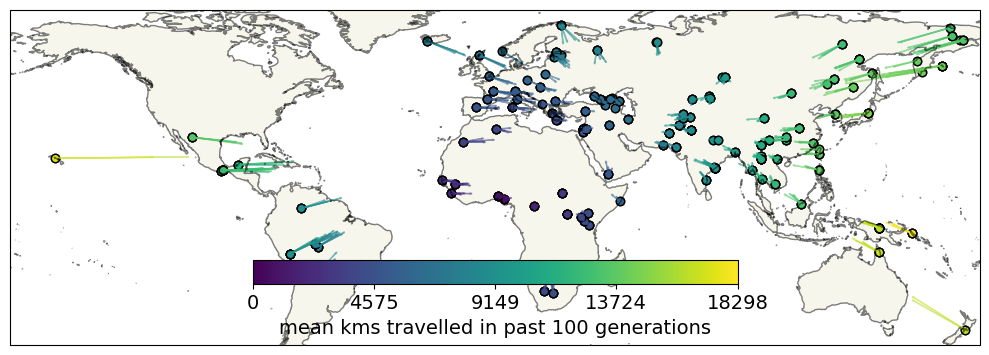

Time taken to execute the code: 11.2384 seconds


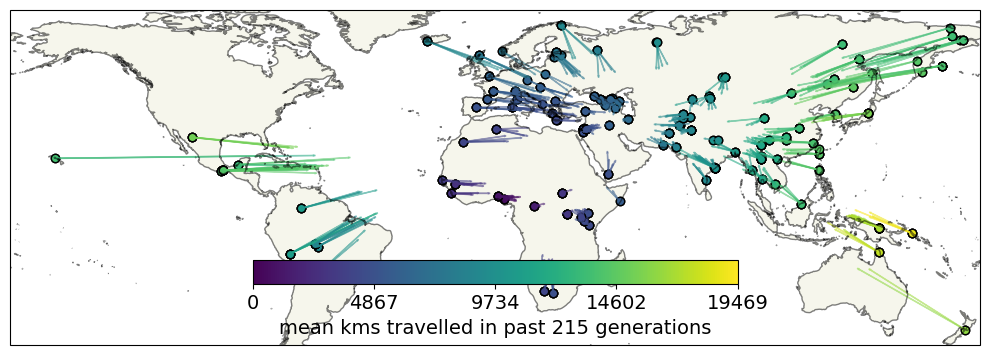

Time taken to execute the code: 11.0747 seconds


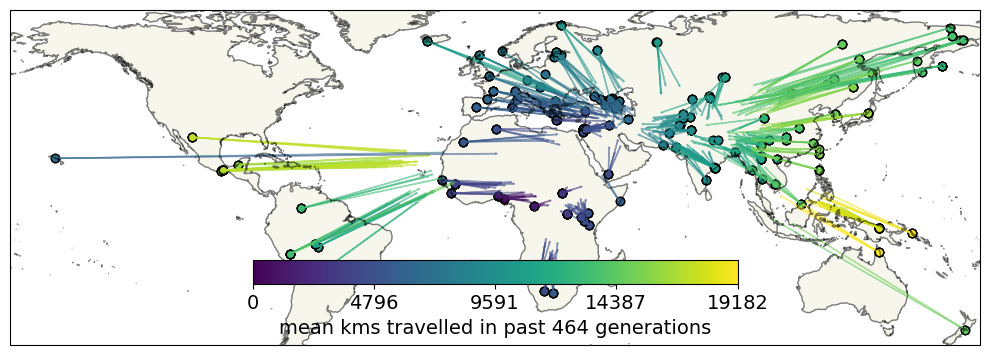

Time taken to execute the code: 12.0343 seconds


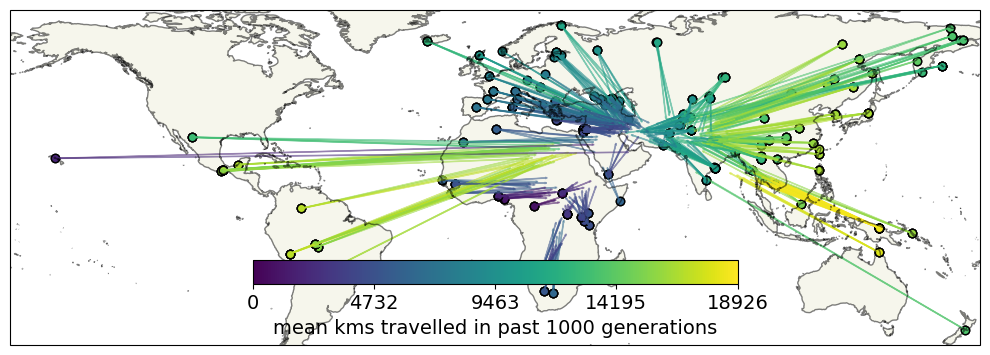

Time taken to execute the code: 10.7980 seconds


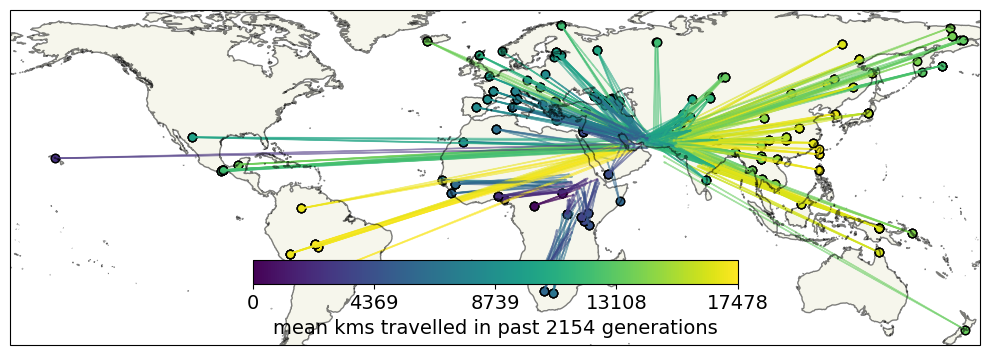

Time taken to execute the code: 11.5002 seconds


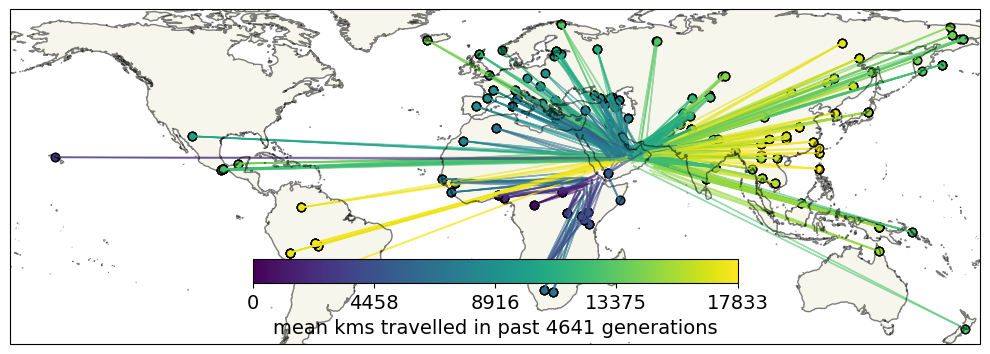

Time taken to execute the code: 11.2952 seconds


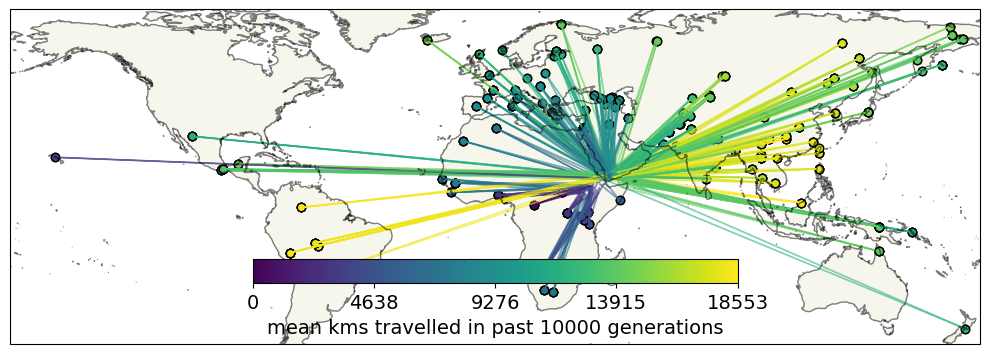

Time taken to execute the code: 11.0088 seconds


In [47]:
time_ixs = range(len(ancestor_times)) #choose which time to get ancestor locations at


for time_ix in time_ixs:
    start_time = time.time()
    disps = []
    for sample in range(n): #for all samples

        locs = anc_locs[:,sample,time_ix]
        #print(locs)
    #     row_mask = (locs != locations[sample]).all(axis=1)
    #     locs = locs[row_mask,:] #exclude subtrees that contain only the sample
        mean_loc = np.mean(locs, axis=0)
        #print(mean_loc,locations[sample])
        disp = mean_loc - locations[sample]
        disps.append(disp)
        dists = [haversine(locations[i], disp) for i,disp in enumerate(disps)]
        relative_dists = dists/np.max(dists)
        np.mean(dists)
        
    fig = plt.figure(figsize=(10, 4))

    ax = fig.add_subplot(projection=ccrs.PlateCarree())

    for i,disp in enumerate(disps):

        cmap = plt.get_cmap('viridis')
        color = cmap(relative_dists[i])
        #     color = plt.cm.tab10(population_ixs[i])
        ax.scatter(locations[i,0], locations[i,1], color=color, edgecolor='k', zorder=0)
        ax.arrow(locations[i,0], locations[i,1], disp[0], disp[1], transform=ccrs.PlateCarree(),
                 head_width=0.5, length_includes_head=True, width=0.1, alpha=0.5, color=color)
            #ax.annotate(str(i), xy=(locations[i, 0], locations[i, 1]), xytext=(3, 3), textcoords='offset points', 
                        #ha='right', fontsize=8, transform=ccrs.PlateCarree())

    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    cbar = fig.colorbar(plt.cm.ScalarMappable(norm=None, cmap=cmap), ax=ax, orientation='horizontal', pad=-0.25, shrink=0.5)
    cbar.set_ticks([i/4 for i in range(5)])
    cbar.set_ticklabels([round(i*max(dists)/4) for i in range(5)])
    cbar.set_label('mean kms travelled in past %d generations' %int(ancestor_times[time_ix]), fontsize=14)
    cbar.ax.tick_params(labelsize=14)

    plt.tight_layout()
    
    filename = f'time_ixs_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()
    
    end_time = time.time()
    elapsed_time = end_time - start_time
    print(f"Time taken to execute the code: {elapsed_time:.4f} seconds")


## By groups

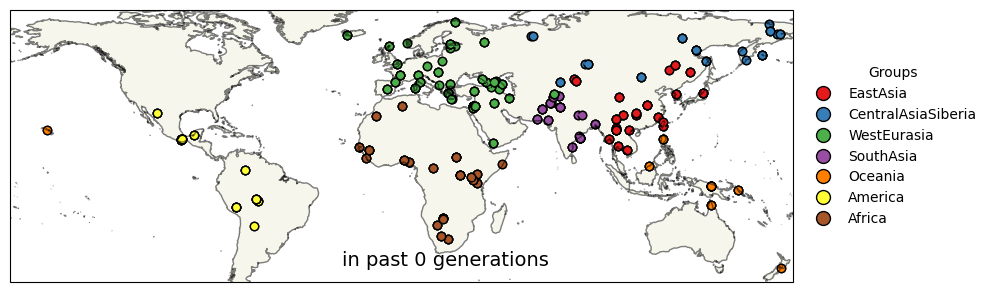

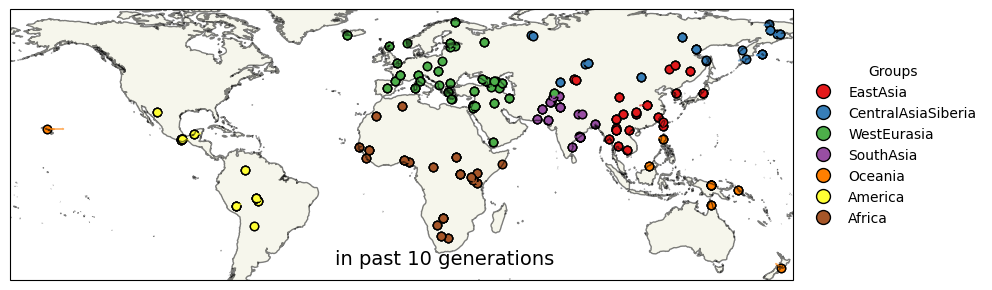

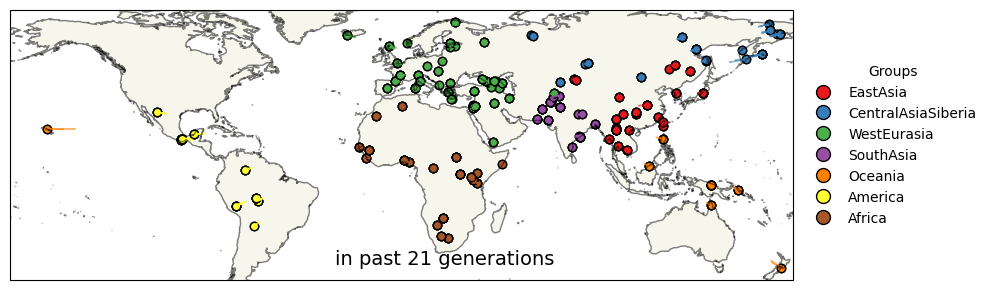

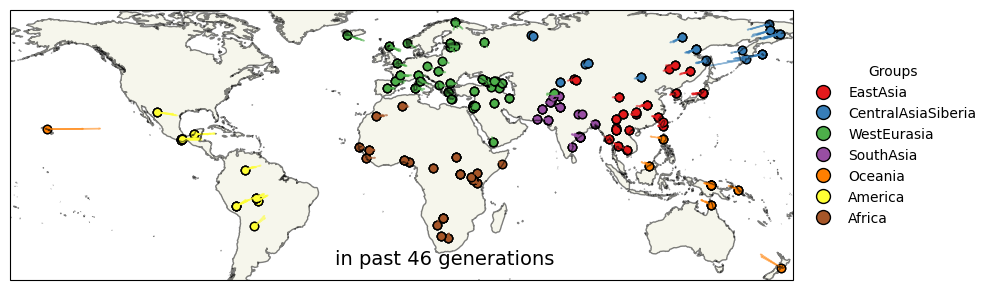

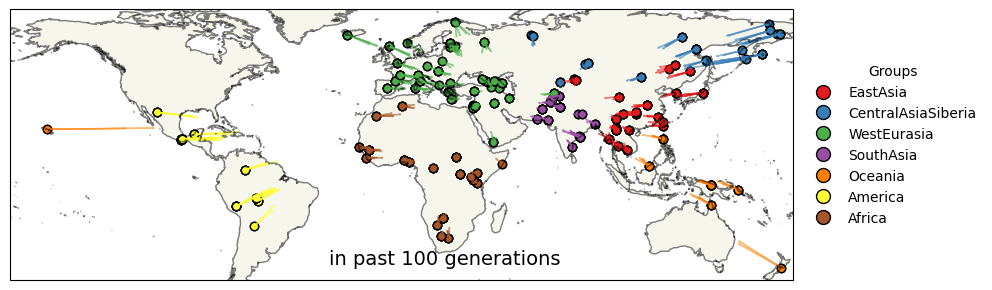

...

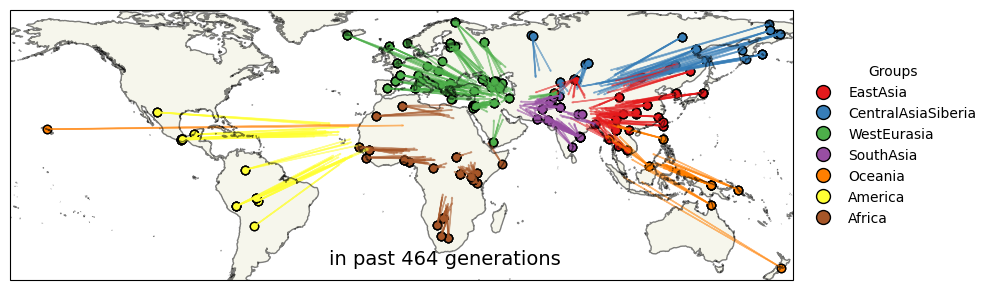

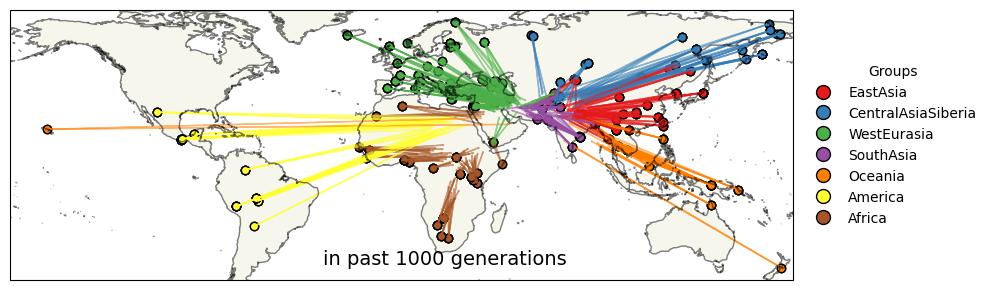

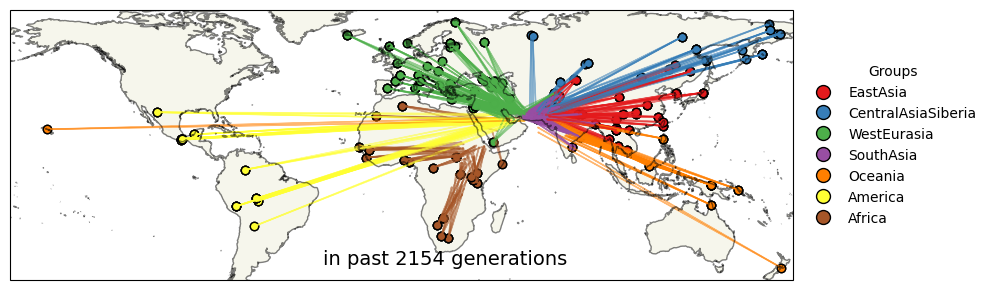

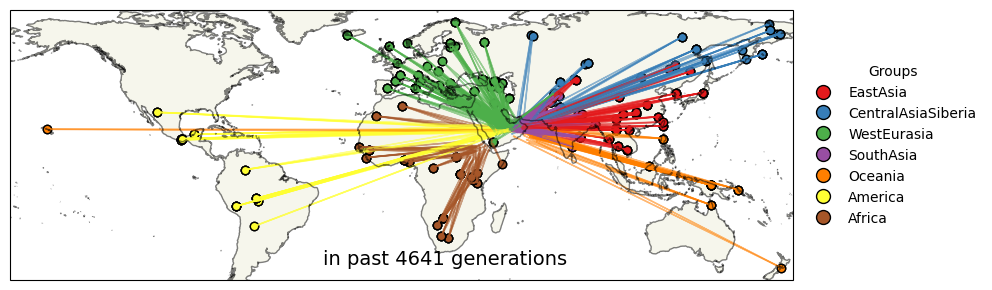

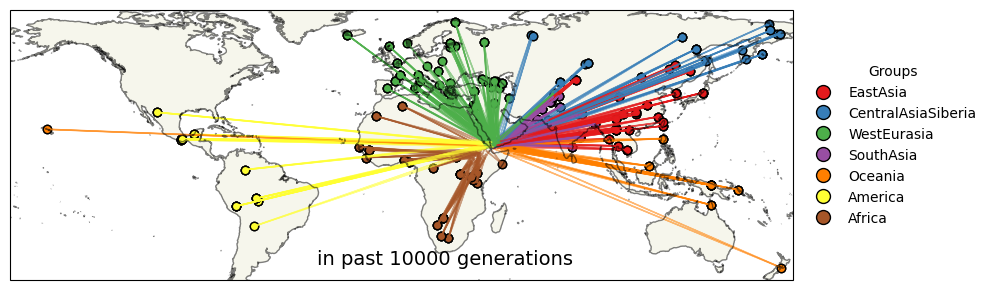

In [35]:
time_ixs = range(len(ancestor_times)) #choose which time to get ancestor locations at

for time_ix in time_ixs:
    disps = []
    for sample in rangee(n): #for all samples

        locs = anc_locs[:,sample,time_ix]
        #print(locs)
    #     row_mask = (locs != locations[sample]).all(axis=1)
    #     locs = locs[row_mask,:] #exclude subtrees that contain only the sample
        mean_loc = np.mean(locs, axis=0)
        #print(mean_loc,locations[sample])
        disp = mean_loc - locations[sample]
        disps.append(disp)
        dists = [haversine(locations[i], disp) for i,disp in enumerate(disps)]
        relative_dists = dists/np.max(dists)
        np.mean(dists)
        
    fig = plt.figure(figsize=(10, 4))

    ax = fig.add_subplot(projection=ccrs.PlateCarree())

    for i,disp in enumerate(disps):
        color = group_colors[groups[i]]

        #     color = plt.cm.tab10(population_ixs[i])
        ax.scatter(locations[i,0], locations[i,1], color=color, edgecolor='k', zorder=0)
        ax.arrow(locations[i,0], locations[i,1], disp[0], disp[1], transform=ccrs.PlateCarree(),
                 head_width=0.5, length_includes_head=True, width=0.1, alpha=0.5, color=color)
            #ax.annotate(str(i), xy=(locations[i, 0], locations[i, 1]), xytext=(3, 3), textcoords='offset points', 
                        #ha='right', fontsize=8, transform=ccrs.PlateCarree())

    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=group_colors[group], 
                markeredgecolor='k', markersize=10, linestyle='') for group in unique_strings]

    # group legends
    ax.legend(handles, unique_strings, title="Groups", loc='center right', bbox_to_anchor=(1.25, 0.5), frameon=False)
    
    # time
    fig.text(0.4, 0.2, 'in past %d generations' %int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()
    
    filename = f'time_ixs_group_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()


#non tree mean location of contamperory samples as null

#lon & lat, red & blue grouping, by location 
#color by group colors (arrow & pooints), don't color by distance,

#add all ancestor locations (all the point, opacity...) by group/lonlat, no arrows

#color by mean displacement over time?? samples -- smooth out? light red - dark red


## By longlat

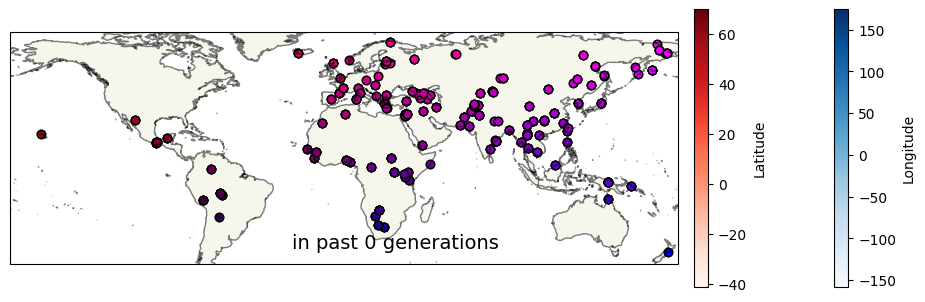

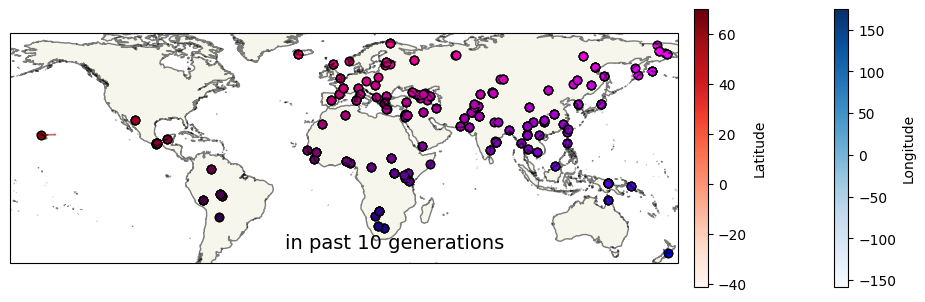

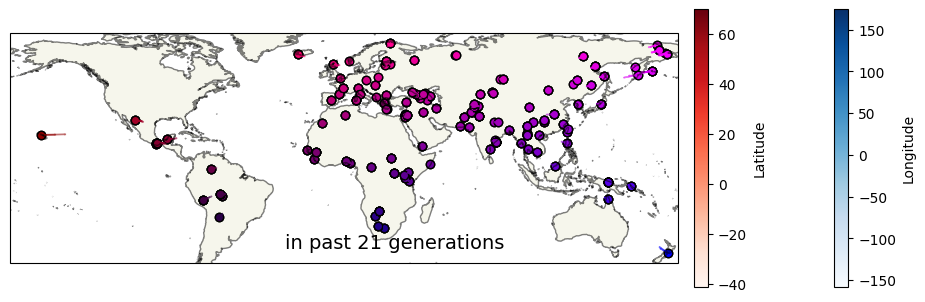

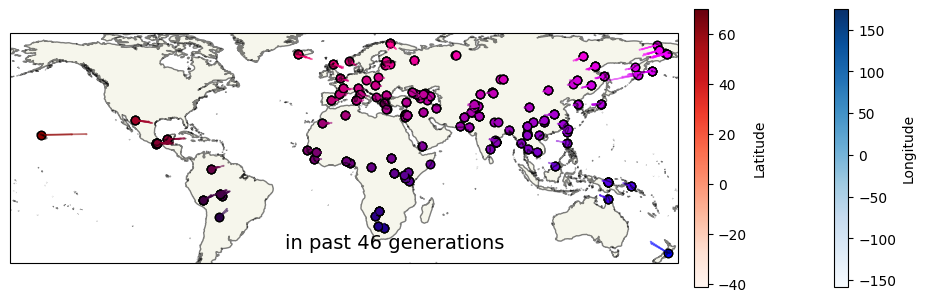

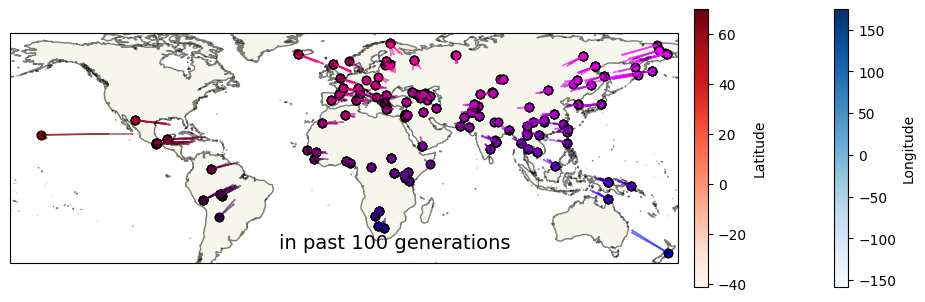

...

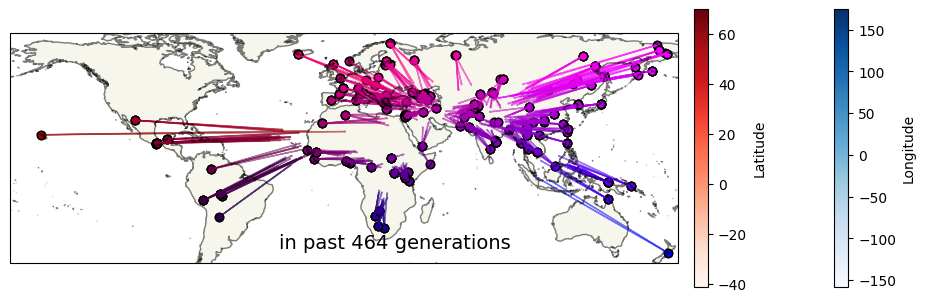

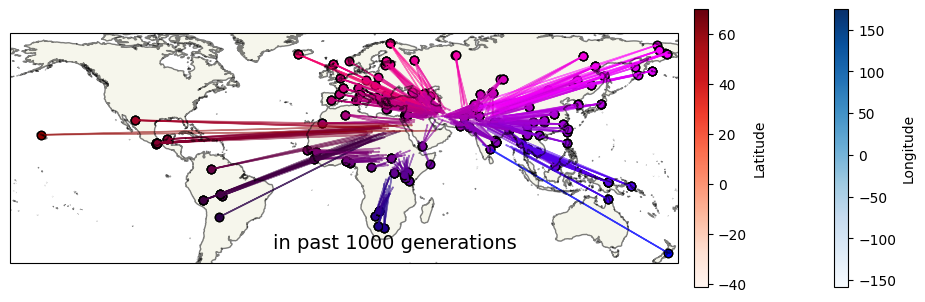

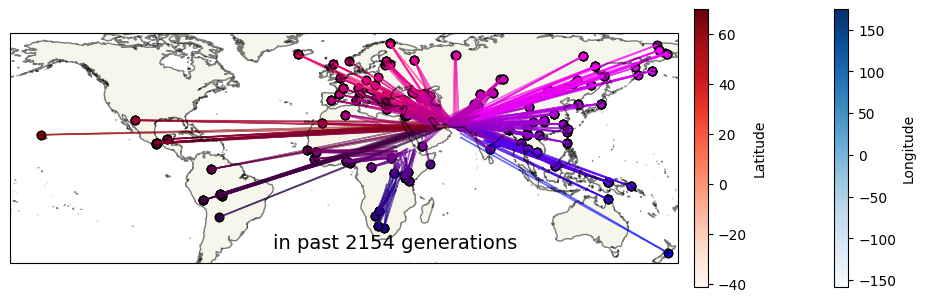

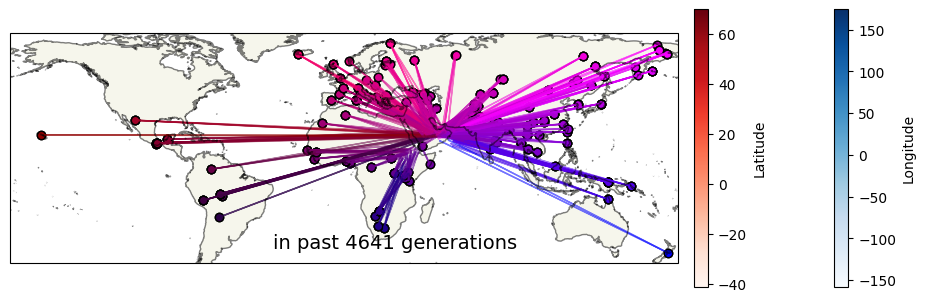

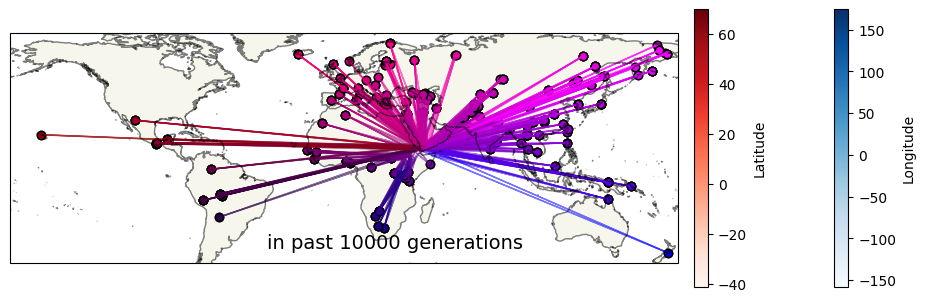

In [50]:
time_ixs = range(len(ancestor_times)) #choose which time to get ancestor locations at

for time_ix in time_ixs:
    disps = []
    for sample in range(n): #for all samples

        locs = anc_locs[:,sample,time_ix]
        #print(locs)
    #     row_mask = (locs != locations[sample]).all(axis=1)
    #     locs = locs[row_mask,:] #exclude subtrees that contain only the sample
        mean_loc = np.mean(locs, axis=0)
        #print(mean_loc,locations[sample])
        disp = mean_loc - locations[sample]
        disps.append(disp)
        dists = [haversine(locations[i], disp) for i,disp in enumerate(disps)]
        relative_dists = dists/np.max(dists)
        np.mean(dists)
        
        
    fig = plt.figure(figsize=(10, 4))

    ax = fig.add_subplot(projection=ccrs.PlateCarree())

    for i,disp in enumerate(disps):

                
        longitudes = locations[:, 0]
        latitudes = locations[:, 1]
        # normalize long and lat
        norm_longitudes = (longitudes[i] - longitudes.min()) / (longitudes.max() - longitudes.min())
        norm_latitudes = (latitudes[i] - latitudes.min()) / (latitudes.max() - latitudes.min())

        # Create color array by combining red for latitude and blue for longitude
        color = np.zeros(3)  # RGB array
        color[0] = norm_latitudes  # Red channel
        color[2] = norm_longitudes  # Blue channel
        ax.scatter(locations[i,0], locations[i,1], color=color, edgecolor='k', zorder=0)
        ax.arrow(locations[i,0], locations[i,1], disp[0], disp[1], transform=ccrs.PlateCarree(),
                 head_width=0.5, length_includes_head=True, width=0.1, alpha=0.5, color=color)
            #ax.annotate(str(i), xy=(locations[i, 0], locations[i, 1]), xytext=(3, 3), textcoords='offset points', 
                        #ha='right', fontsize=8, transform=ccrs.PlateCarree())
    
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)
    
    # long label
    norm = plt.Normalize(vmin=longitudes.min(), vmax=longitudes.max())
    sm = plt.cm.ScalarMappable(cmap=plt.cm.Blues, norm=norm)
    sm.set_array([])
    cbar_lon = plt.colorbar(sm, ax=ax, orientation='vertical', pad=0.02, shrink=0.75)
    cbar_lon.set_label('Longitude')
    
    # lat label
    norm_lat = plt.Normalize(vmin=latitudes.min(), vmax=latitudes.max())
    sm_lat = plt.cm.ScalarMappable(cmap=plt.cm.Reds, norm=norm_lat)
    sm_lat.set_array([])
    cbar_lat = plt.colorbar(sm_lat, ax=ax, orientation='vertical', pad=0.02, location='right', shrink=0.75)
    cbar_lat.set_label('Latitude')
    
    # time
    fig.text(0.4, 0.25, 'in past %d generations' %int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()    
    filename = f'time_ixs_longlat_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()


## All ancestor locations (by longlat)

In [ ]:
time_ixs = range(len(ancestor_times)) #choose which time to get ancestor locations at

for time_ix in time_ixs:
    start_time = time.time()
    
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    for sample in range(n): #for all samples
        locs = anc_locs[:,sample,time_ix]
        for i,loc in enumerate(locs):
            longitudes = loc[0]
            latitudes = loc[1]
            # normalize long and lat
            norm_longitudes = (longitudes - locations[:,0].min()) / (locations[:,0].max() - locations[:,0].min())
            norm_latitudes = (latitudes - locations[:,1].min()) / (locations[:,1].max() - locations[:,1].min())

            # Create color array by combining red for latitude and blue for longitude
            color = np.zeros(3)  # RGB array
            color[0] = norm_latitudes  # Red channel
            color[2] = norm_longitudes  # Blue channel
            ax.scatter(longitudes, latitudes, color=color, s=1, alpha=0.3, zorder=0)
    
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)
    
    # long label
    norm = plt.Normalize(vmin=longitudes.min(), vmax=longitudes.max())
    sm = plt.cm.ScalarMappable(cmap=plt.cm.Blues, norm=norm)
    sm.set_array([])
    cbar_lon = plt.colorbar(sm, ax=ax, orientation='vertical', pad=0.02, shrink=0.25)
    cbar_lon.set_label('Longitude')
    
    # lat label
    norm_lat = plt.Normalize(vmin=latitudes.min(), vmax=latitudes.max())
    sm_lat = plt.cm.ScalarMappable(cmap=plt.cm.Reds, norm=norm_lat)
    sm_lat.set_array([])
    cbar_lat = plt.colorbar(sm_lat, ax=ax, orientation='vertical', pad=0.02, location='right', shrink=0.25)
    cbar_lat.set_label('Latitude')

    plt.tight_layout()
    
    filename = f'time_ixs_all_longlat_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    
    plt.show()
    plt.close()
    
    end_time = time.time()
    elapsed_time = end_time - start_time
    print(f"Time taken to execute the code: {elapsed_time:.4f} seconds")


## All ancestor locations (by group)

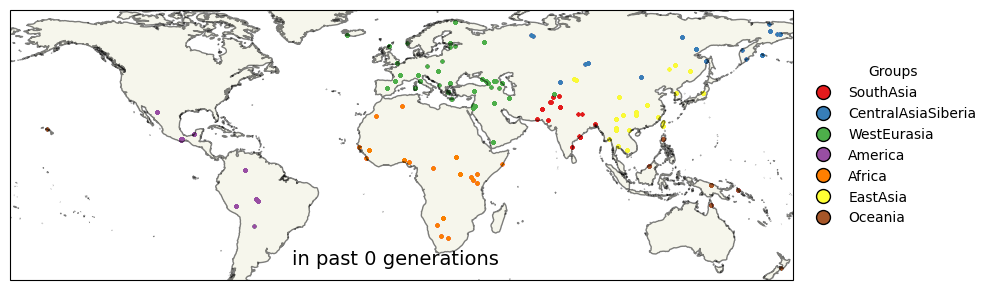

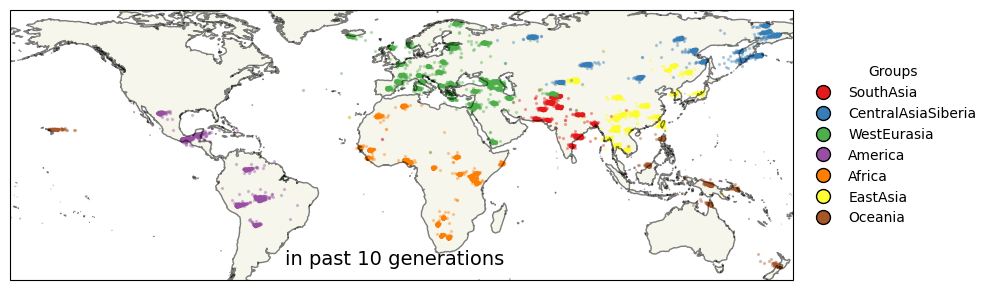

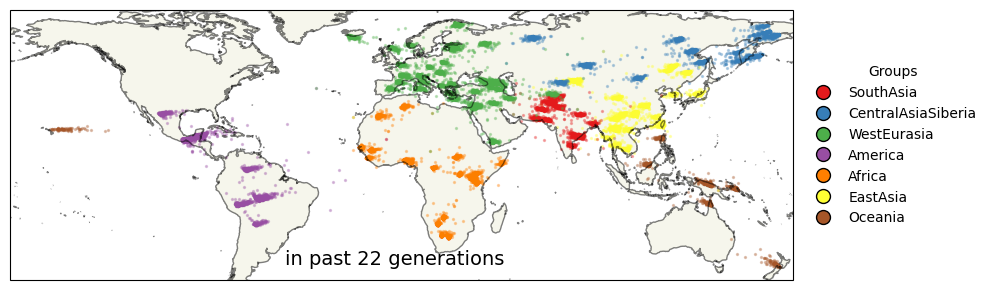

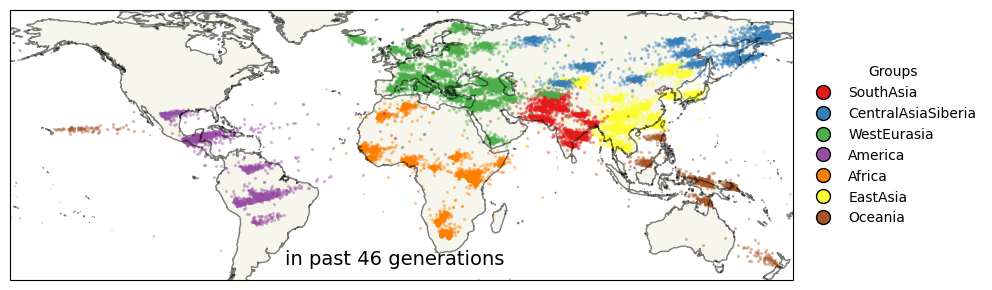

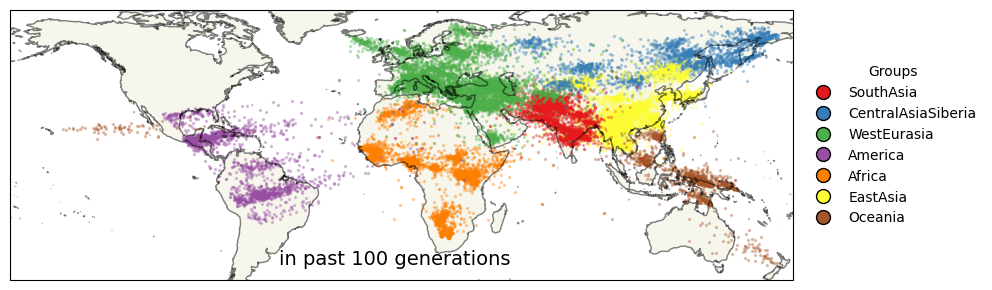

...

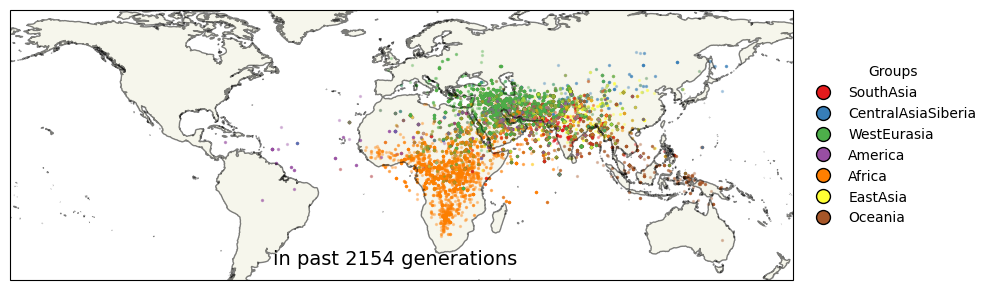

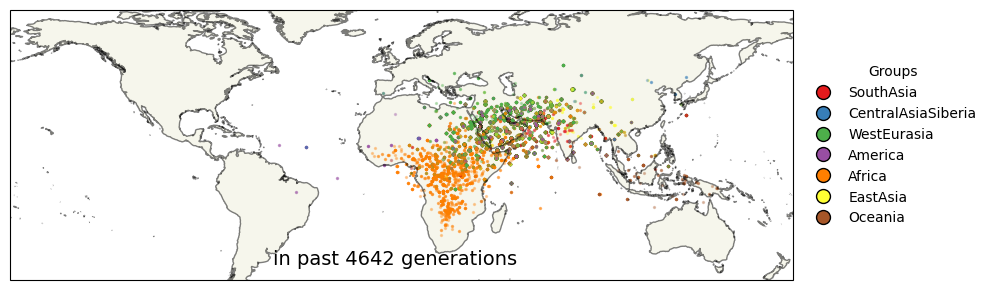

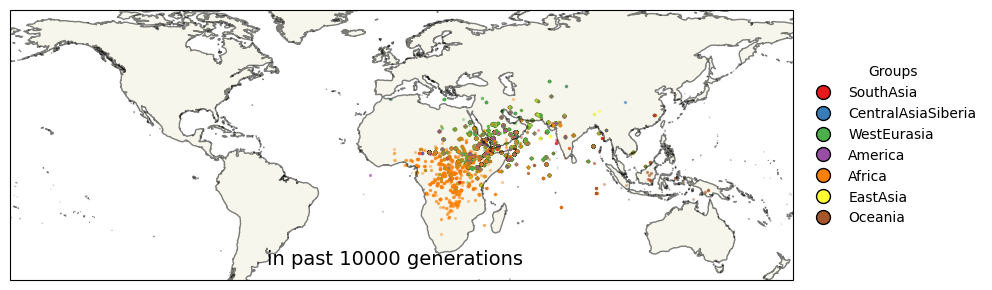

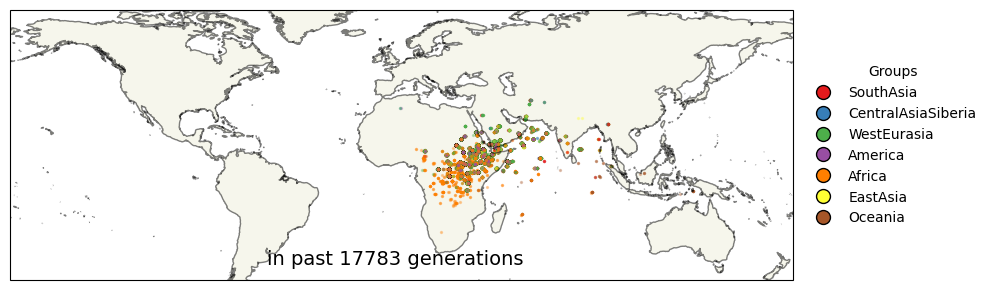

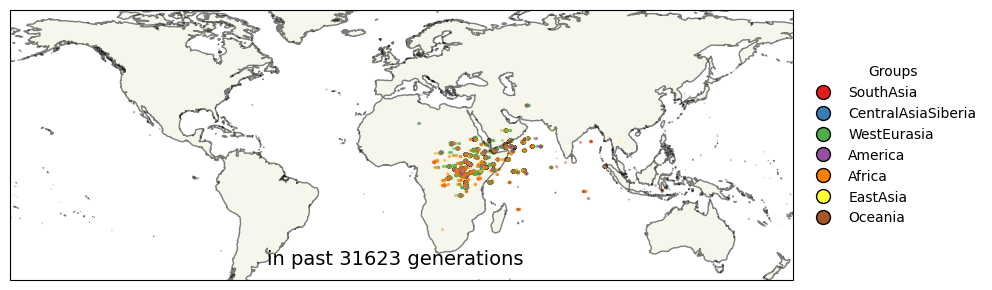

In [18]:
time_ixs = range(len(ancestor_times))[:-2] #choose which time to get ancestor locations at
#extent = [-180, 180, -90, 90] # global extent

for time_ix in time_ixs:
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    for sample in range(n): #for all samples
        locs = anc_locs[:,sample,time_ix]
        color = group_colors[groups[sample]]
        ax.scatter(locs[:,0], locs[:,1], color=color, s=2, alpha=0.3, zorder=0)

    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=group_colors[group], 
                markeredgecolor='k', markersize=10, linestyle='') for group in unique_strings]

    # Add legend to the plot
    ax.legend(handles, unique_strings, title="Groups", loc='center right', bbox_to_anchor=(1.25, 0.5), frameon=False)

    # time
    fig.text(0.4, 0.2, 'in past %d generations' %int(ancestor_times[time_ix]), ha='center', fontsize=14)
    
    plt.tight_layout()
    
    filename = f'time_ixs_all_group_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    
    plt.show()
    plt.close()

## Denstiy plot of all samples

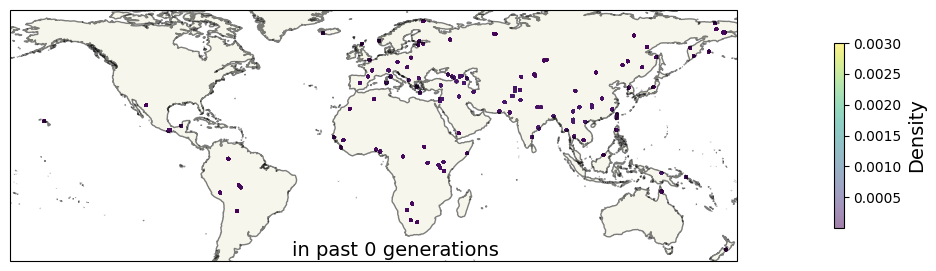

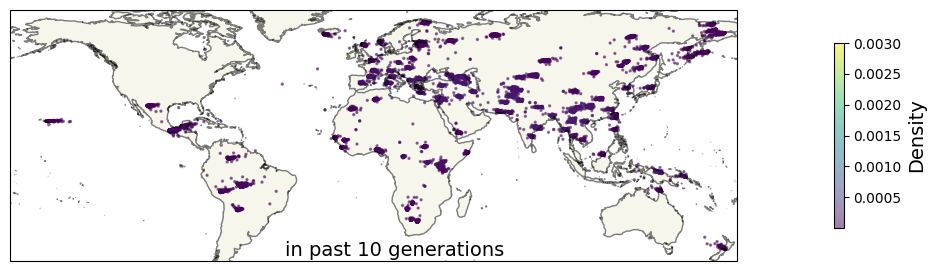

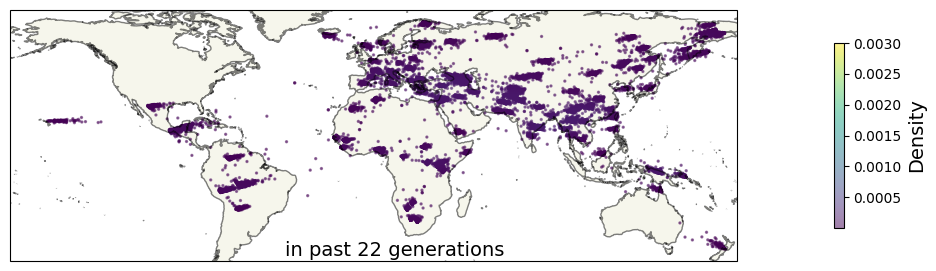

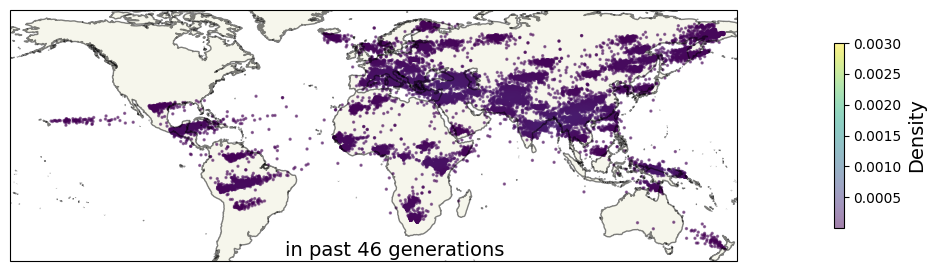

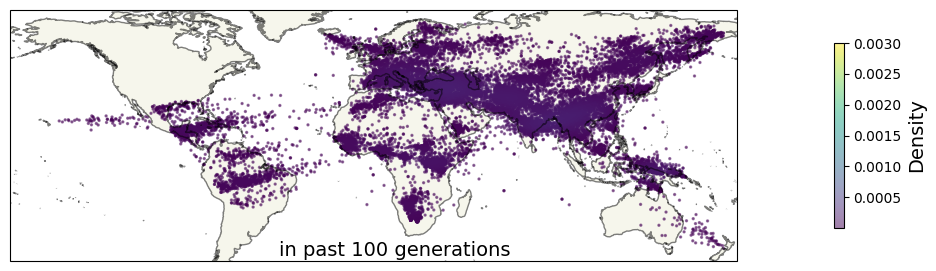

...

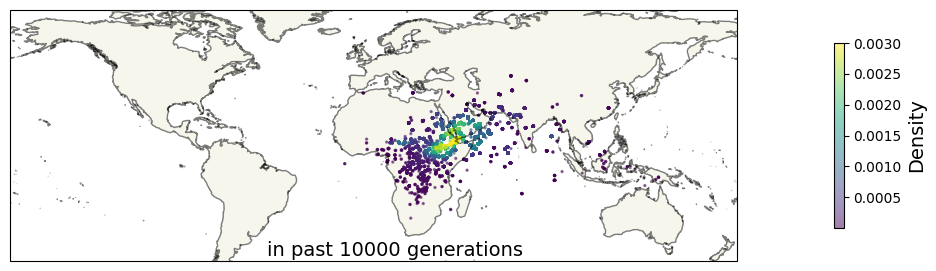

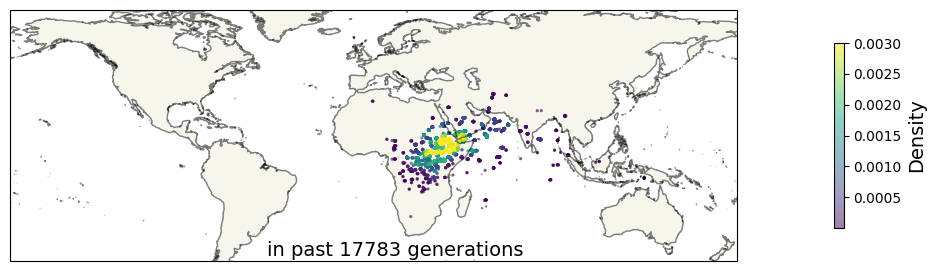

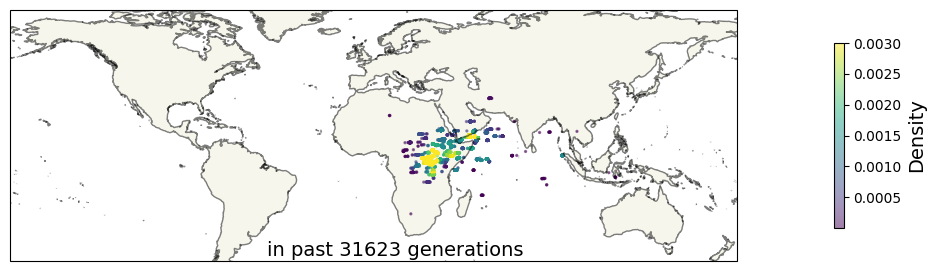

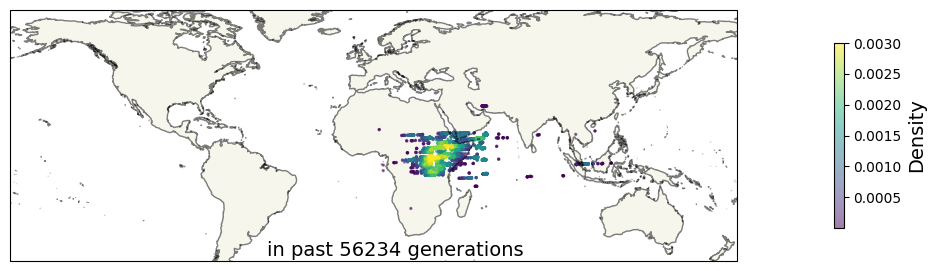

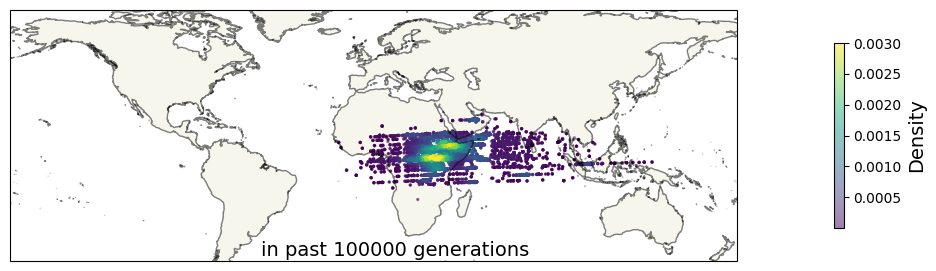

In [195]:
time_ixs = range(len(ancestor_times))

for time_ix in time_ixs:
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # Collect all locations for the given time index
    all_locs = []
    for sample in range(n):  # for all samples
        locs = anc_locs[:, sample, time_ix]
        all_locs.append(locs)

    all_locs = np.vstack(all_locs)  # Combine all locations into one array

    # Calculate the point density
    xy = np.vstack([all_locs[:, 0], all_locs[:, 1]])
    kde = gaussian_kde(xy, bw_method='scott')  # You can adjust bandwidth with bw_method
    z = kde(xy)
    
    global_min_density = 0.000005
    global_max_density = 0.003
    z_norm = (z - global_min_density) / (global_max_density - global_min_density)

    # Create a scatter plot with density colors
    sc = ax.scatter(all_locs[:, 0], all_locs[:, 1], c=z, s=2, cmap='viridis', alpha=0.5, zorder=0)
    sc.set_clim(global_min_density, global_max_density)

    # Add coastlines and land features
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    # Add a color bar
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.1, shrink=0.5)
    cbar.set_label('Density', fontsize=14)

    # Add time text
    fig.text(0.4, 0.2, 'in past %d generations' % int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()

    # Save the figure
    filename = f'time_ixs_density_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()

__Africa group density__

In [140]:
extent

(-174.41500000000002, 180.0, -46.86, 75.46000000000001)

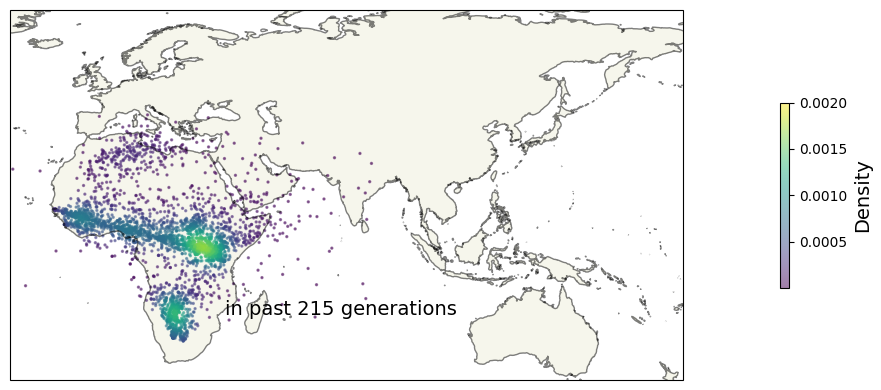

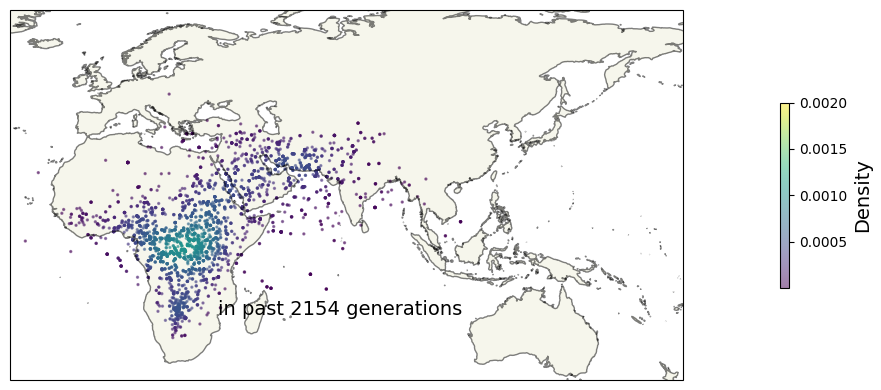

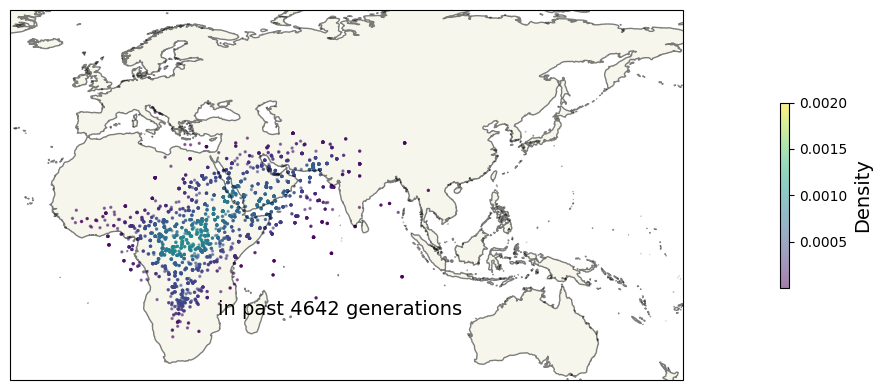

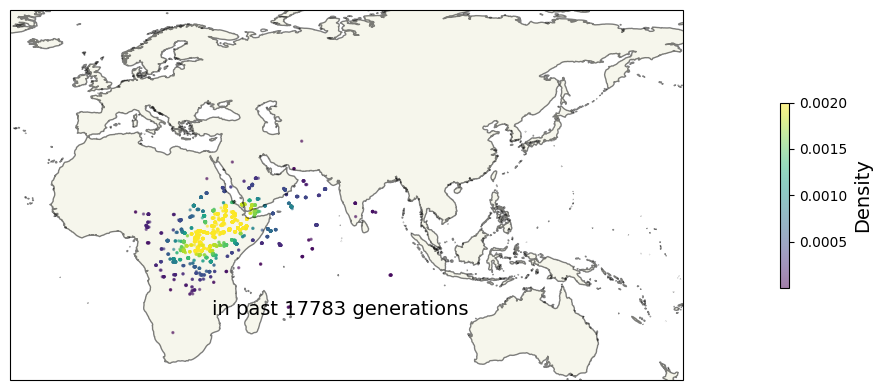

In [147]:
time_ixs = [5,8,9,11]
group_name = 'Africa'
extent = [-30,180,-40, 75.46]


group_samples = [i for i, name in enumerate(groups) if name == group_name]
for time_ix in time_ixs:
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # Collect all locations for the given time index
    all_locs = []
    for sample in group_samples:  # for samples in group
        locs = anc_locs[:, sample, time_ix]
        all_locs.append(locs)

    all_locs = np.vstack(all_locs)  # Combine all locations into one array

    # Calculate the point density
    xy = np.vstack([all_locs[:, 0], all_locs[:, 1]])
    kde = gaussian_kde(xy, bw_method='scott') 
    z = kde(xy)
    
    global_min_density = 0.000005
    global_max_density = 0.002

    # Create a scatter plot with density colors
    sc = ax.scatter(all_locs[:, 0], all_locs[:, 1], c=z, s=2, cmap='viridis', alpha=0.5, zorder=0)
    sc.set_clim(global_min_density, global_max_density)

    # Add coastlines and land features
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    # Add a color bar
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.1, shrink=0.5)
    cbar.set_label('Density', fontsize=14)

    # Add time text
    fig.text(0.4, 0.2, 'in past %d generations' % int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()

    # Save the figure
    filename = group_name + f'_density_time_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()

__Asia group density__

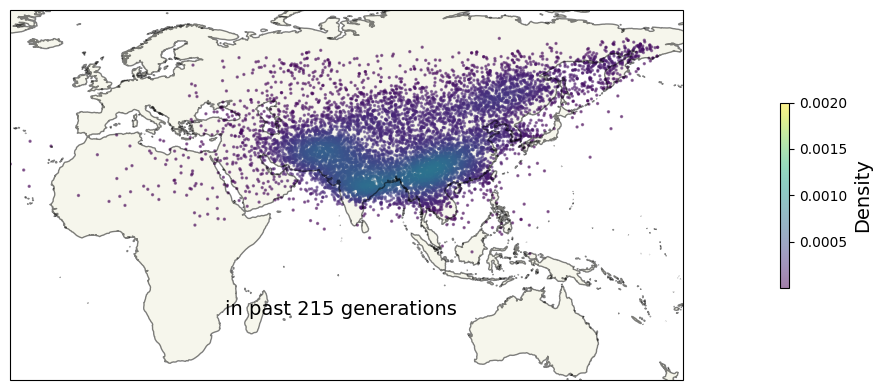

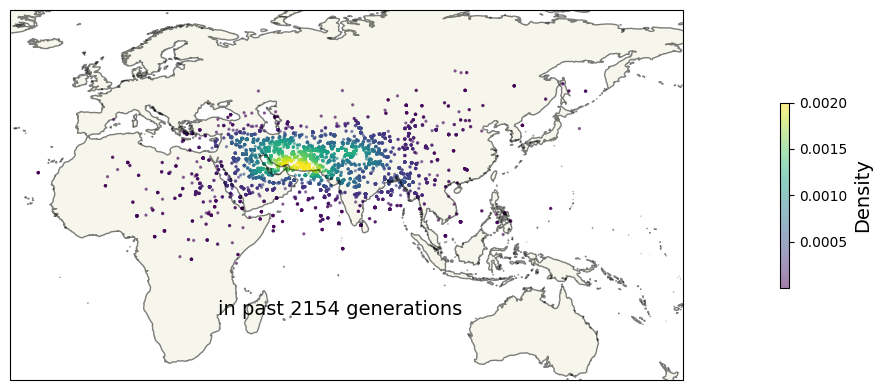

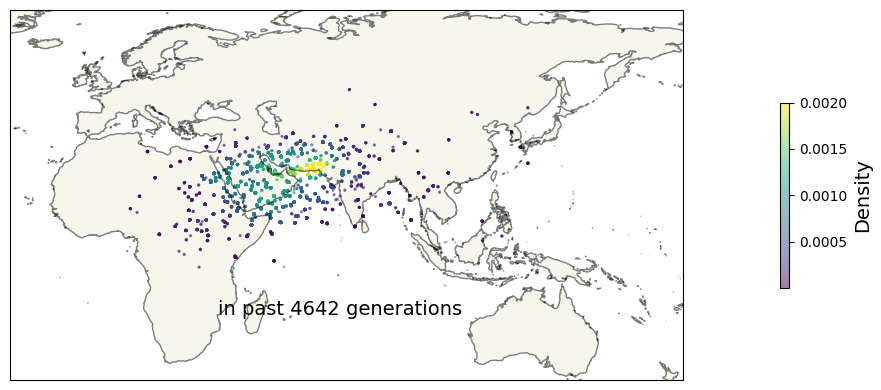

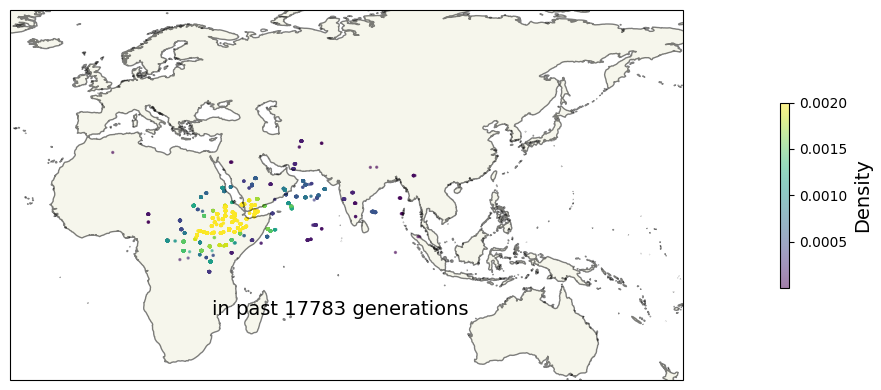

In [148]:
time_ixs = [5,8,9,11]
group_name = ['CentralAsiaSiberia', 'EastAsia', 'SouthAsia']

group_samples = [i for i, name in enumerate(groups) if name in group_name]
for time_ix in time_ixs:
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # Collect all locations for the given time index
    all_locs = []
    for sample in group_samples:  # for samples in group
        locs = anc_locs[:, sample, time_ix]
        all_locs.append(locs)

    all_locs = np.vstack(all_locs)  # Combine all locations into one array

    # Calculate the point density
    xy = np.vstack([all_locs[:, 0], all_locs[:, 1]])
    kde = gaussian_kde(xy, bw_method='scott') 
    z = kde(xy)
    
    global_min_density = 0.000005
    global_max_density = 0.002

    # Create a scatter plot with density colors
    sc = ax.scatter(all_locs[:, 0], all_locs[:, 1], c=z, s=2, cmap='viridis', alpha=0.5, zorder=0)
    sc.set_clim(global_min_density, global_max_density)

    # Add coastlines and land features
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    # Add a color bar
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.1, shrink=0.5)
    cbar.set_label('Density', fontsize=14)

    # Add time text
    fig.text(0.4, 0.2, 'in past %d generations' % int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()

    # Save the figure
    group_name = 'Asia'
    filename = group_name + f'_density_time_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()

__West Eurasia group density__

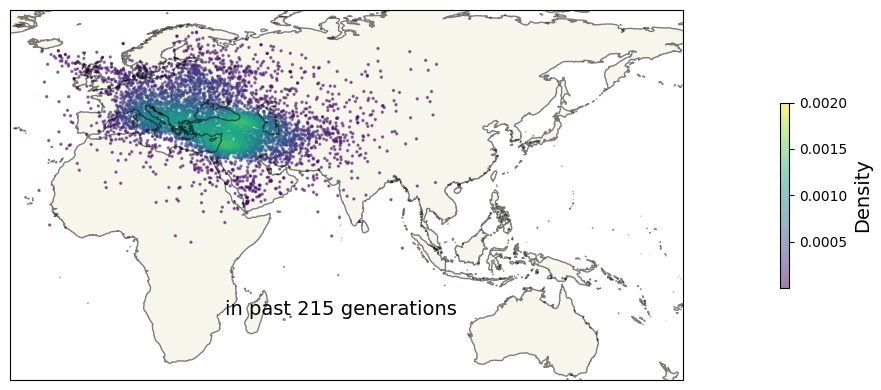

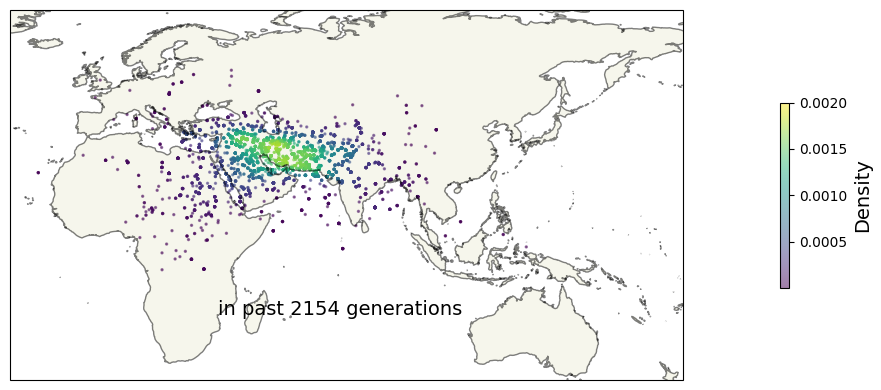

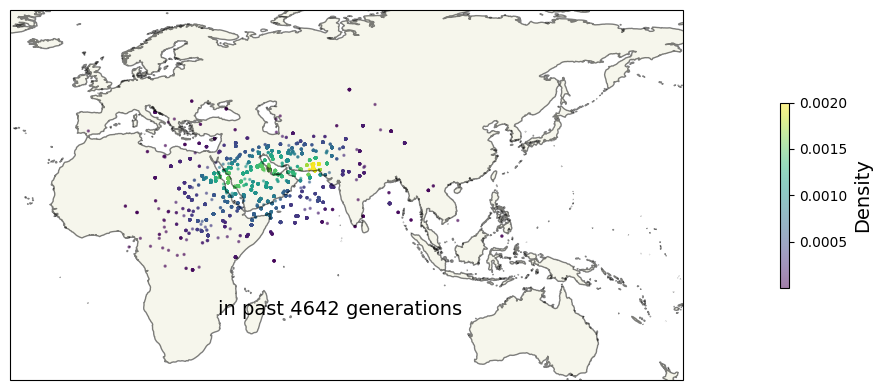

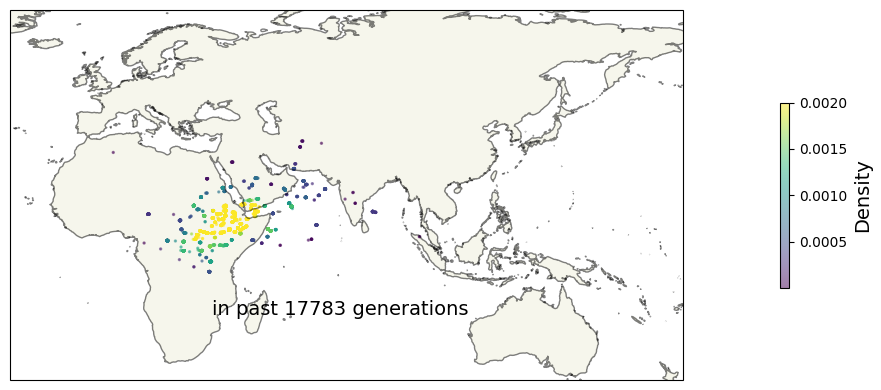

In [149]:
time_ixs = [5,8,9,11]
group_name = 'WestEurasia'

group_samples = [i for i, name in enumerate(groups) if name == group_name]
for time_ix in time_ixs:
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # Collect all locations for the given time index
    all_locs = []
    for sample in group_samples:  # for samples in group
        locs = anc_locs[:, sample, time_ix]
        all_locs.append(locs)

    all_locs = np.vstack(all_locs)  # Combine all locations into one array

    # Calculate the point density
    xy = np.vstack([all_locs[:, 0], all_locs[:, 1]])
    kde = gaussian_kde(xy, bw_method='scott') 
    z = kde(xy)
    
    global_min_density = 0.000005
    global_max_density = 0.002

    # Create a scatter plot with density colors
    sc = ax.scatter(all_locs[:, 0], all_locs[:, 1], c=z, s=2, cmap='viridis', alpha=0.5, zorder=0)
    sc.set_clim(global_min_density, global_max_density)

    # Add coastlines and land features
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    # Add a color bar
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.1, shrink=0.5)
    cbar.set_label('Density', fontsize=14)

    # Add time text
    fig.text(0.4, 0.2, 'in past %d generations' % int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()

    # Save the figure
    filename = group_name + f'_density_time_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()

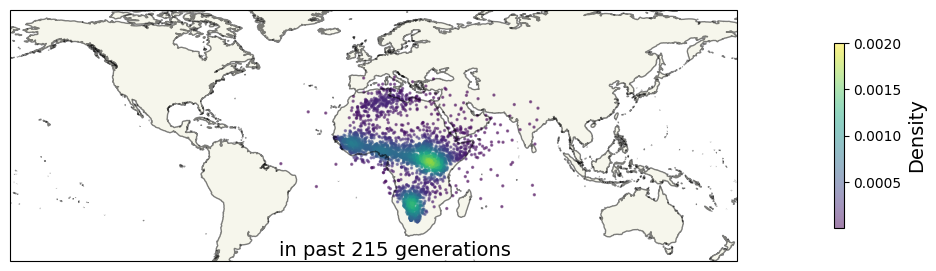

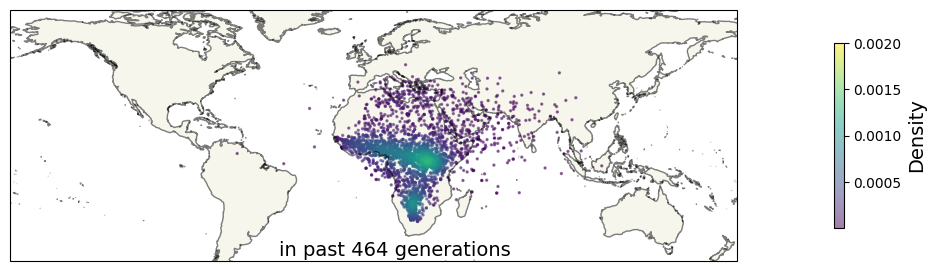

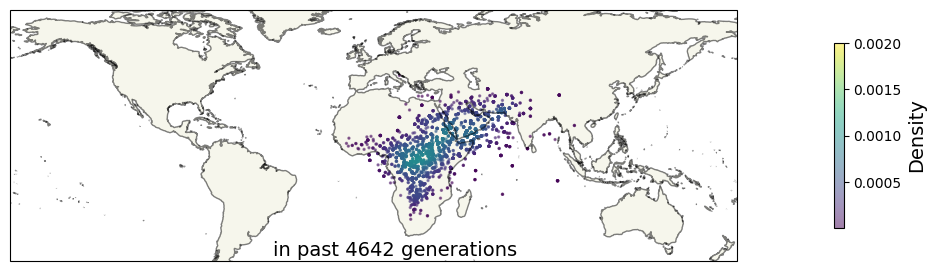

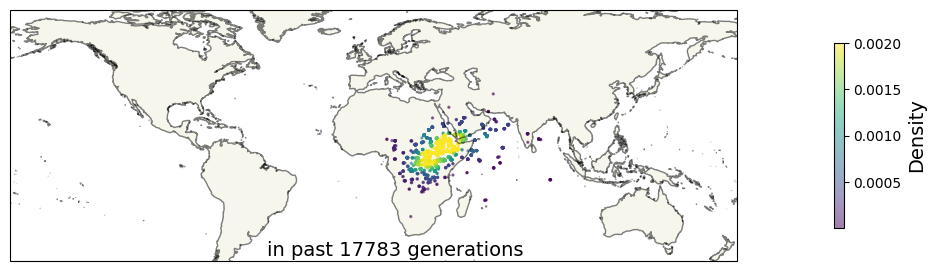

In [136]:
time_ixs = [5,6,9,11]
group_name = 'Africa'

group_samples = [i for i, name in enumerate(groups) if name == group_name]
for time_ix in time_ixs:
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # Collect all locations for the given time index
    all_locs = []
    for sample in group_samples:  # for samples in group
        locs = anc_locs[:, sample, time_ix]
        all_locs.append(locs)

    all_locs = np.vstack(all_locs)  # Combine all locations into one array

    # Calculate the point density
    xy = np.vstack([all_locs[:, 0], all_locs[:, 1]])
    kde = gaussian_kde(xy, bw_method='scott') 
    z = kde(xy)
    
    global_min_density = 0.000005
    global_max_density = 0.002

    # Create a scatter plot with density colors
    sc = ax.scatter(all_locs[:, 0], all_locs[:, 1], c=z, s=2, cmap='viridis', alpha=0.5, zorder=0)
    sc.set_clim(global_min_density, global_max_density)

    # Add coastlines and land features
    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

    # Add a color bar
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.1, shrink=0.5)
    cbar.set_label('Density', fontsize=14)

    # Add time text
    fig.text(0.4, 0.2, 'in past %d generations' % int(ancestor_times[time_ix]), ha='center', fontsize=14)

    plt.tight_layout()

    # Save the figure
    filename = group_name + f'_density_time_{time_ix:02d}.png'  # add index
    plt.savefig(os.path.join(plotdir, filename))
    plt.show()
    plt.close()

## Mean location dispersal by time

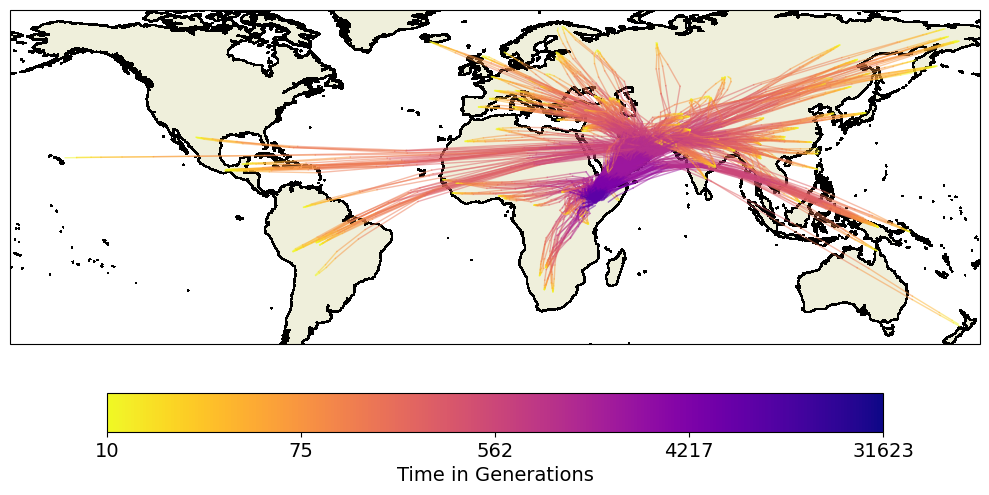

In [52]:
time_ixs = range(len(ancestor_times))
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection=ccrs.PlateCarree())
ax.set_extent(extent, crs=ccrs.PlateCarree())
cmap = plt.get_cmap("plasma_r")


for sample in range(556): #for all samples
    mean_locs = []
    time_loc = locations[sample]
    for time_ix in time_ixs[1:]:
        locs = anc_locs[:,sample,time_ix]
        mean_loc = np.mean(locs, axis=0)        
        mean_locs.append(mean_loc)
    mean_locs = np.array(mean_locs)

    for i in range(len(mean_locs) - 1):
        color = cmap(i / len(mean_locs))
        ax.plot(mean_locs[i:i+2, 0], mean_locs[i:i+2, 1], color=color,lw=1,alpha=0.5)

    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

cbar = fig.colorbar(plt.cm.ScalarMappable(norm=None, cmap=cmap), ax=ax, orientation='horizontal', pad=0.05, shrink=0.8)
cbar.set_ticks([i/4 for i in range(0,5)])
cbar.set_ticklabels(np.round(np.logspace(1,np.log10(ancestor_times[time_ix]),5)).astype(int).tolist())
cbar.set_label(('Time in Generations'), fontsize=14)
cbar.ax.tick_params(labelsize=14)
    

plt.tight_layout()
filename = f'time_ixs_time.png'  
plt.savefig(os.path.join(plotdir, filename))
plt.show()
plt.close()


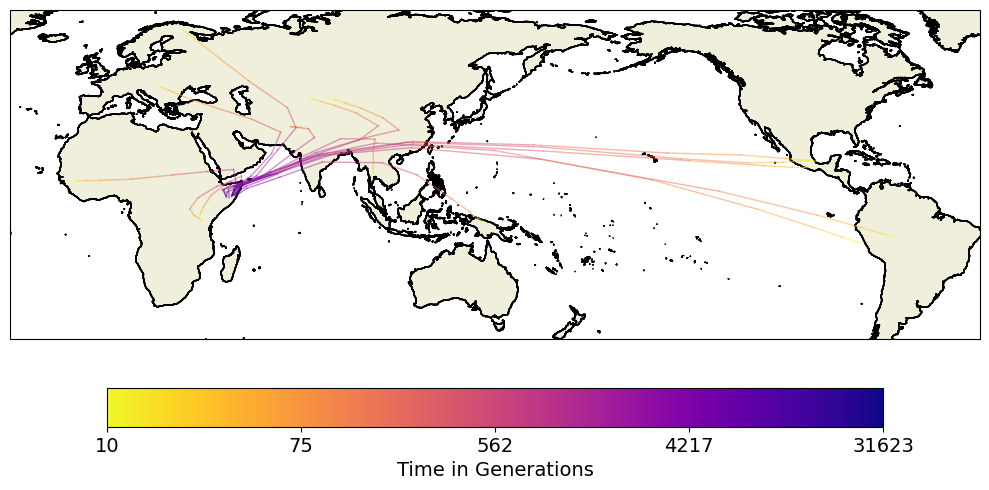

In [158]:
time_ixs = range(len(ancestor_times))
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection=ccrs.PlateCarree(central_longitude=+145))
ax.set_extent(extent, crs=ccrs.PlateCarree())
cmap = plt.get_cmap("plasma_r")


for sample in range(len(selected_samples)): #for all samples
    mean_locs = []
    time_loc = new_locations[sample]
    for time_ix in time_ixs[1:]:
        locs = anc_locs_proj[:,sample,time_ix]
        mean_loc = np.mean(locs, axis=0)        
        mean_locs.append(mean_loc)
    mean_locs = np.array(mean_locs)

    for i in range(len(mean_locs) - 1):
        color = cmap(i / len(mean_locs))
        ax.plot(mean_locs[i:i+2, 0], mean_locs[i:i+2, 1], color=color,lw=1,alpha=0.5)

    ax.coastlines(resolution='50m', alpha=0.5)
    ax.add_feature(cfeature.LAND, alpha=0.5)

cbar = fig.colorbar(plt.cm.ScalarMappable(norm=None, cmap=cmap), ax=ax, orientation='horizontal', pad=0.05, shrink=0.8)
cbar.set_ticks([i/4 for i in range(0,5)])
cbar.set_ticklabels(np.round(np.logspace(1,np.log10(ancestor_times[time_ix]),5)).astype(int).tolist())
cbar.set_label(('Time in Generations'), fontsize=14)
cbar.ax.tick_params(labelsize=14)
    

plt.tight_layout()
#filename = f'time_ixs_time.png'  
#plt.savefig(os.path.join(plotdir, filename))
plt.show()
plt.close()

#spatial clustering
#Great cycle distance (haversine)
#QGIS plotting

## Sample trajectory

In [208]:
def plot_migration_trajectories(locations, ancestor_times, time_ixs=None, sample_indices=range(10)):
    
    if time_ixs is None:
        time_ixs = range(len(ancestor_times))
        
    cmap = plt.get_cmap("plasma_r")
    
    for sample in sample_indices:  # Loop over each sample
        mean_locs = []
        for time_ix in time_ixs[1:]:
            locs = anc_locs[:, sample, time_ix]
            mean_loc = np.mean(locs, axis=0)
            mean_locs.append(mean_loc)
        mean_locs = np.array(mean_locs)

        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(projection=ccrs.PlateCarree())
        
            
        # Plot the ancestor and starting points
        for i in [5,8,9,-1]:
            ax.plot(mean_locs[i, 0], mean_locs[i, 1], 'o',color="black", lw=5)
            print(ancestor_times[i])
        ax.plot(locations[sample, 0],locations[sample, 1],'o',color = "white", lw=5, markeredgecolor='k',zorder=5)
        
        # Plot the mean trajectory
        for i in range(len(mean_locs) - 1):
            color = cmap(i / len(mean_locs))
            ax.plot(mean_locs[i:i+2, 0], mean_locs[i:i+2, 1], color="black", lw=2,zorder=4)
        
        # Plot individual loci trajectories
        for locus in range(anc_locs.shape[0]):
            loci_locs = anc_locs[locus, sample, time_ixs]

            # Plot the trajectory for this locus
            for i in range(len(loci_locs) - 1):
                color = cmap(i / len(loci_locs))  # Same coloring method based on progress
                ax.plot(loci_locs[i:i+2, 0], loci_locs[i:i+2, 1], color=color, alpha=0.3, lw=1)

        ax.coastlines(resolution='50m', alpha=0.5)
        ax.add_feature(cfeature.LAND, alpha=0.5)

        # Add color bar
        cbar = fig.colorbar(plt.cm.ScalarMappable(norm=None, cmap=cmap), ax=ax, orientation='horizontal', pad=0.1, shrink=0.5)
        cbar.set_ticks([i / 4 for i in range(5)])
        cbar.set_ticklabels([round(i * ancestor_times[time_ixs[-1]] / 4) for i in range(5)])
        cbar.set_label(f'By Generations', fontsize=14)
        cbar.ax.tick_params(labelsize=14)

        plt.tight_layout()
        plt.show()
        plt.close()

In [204]:
Utsa21 = ids.index(b'S_Saami-1')
CHI = ids.index(b'S_Thai-1')
Mandenka = ids.index(b'S_Mandenka-1')
BantuKenya = ids.index(b'S_BantuKenya-1')
print(Utsa21)
print(CHI)
print(Mandenka)
print(BantuKenya)


205
118
31
20


215
2154
4642
31623


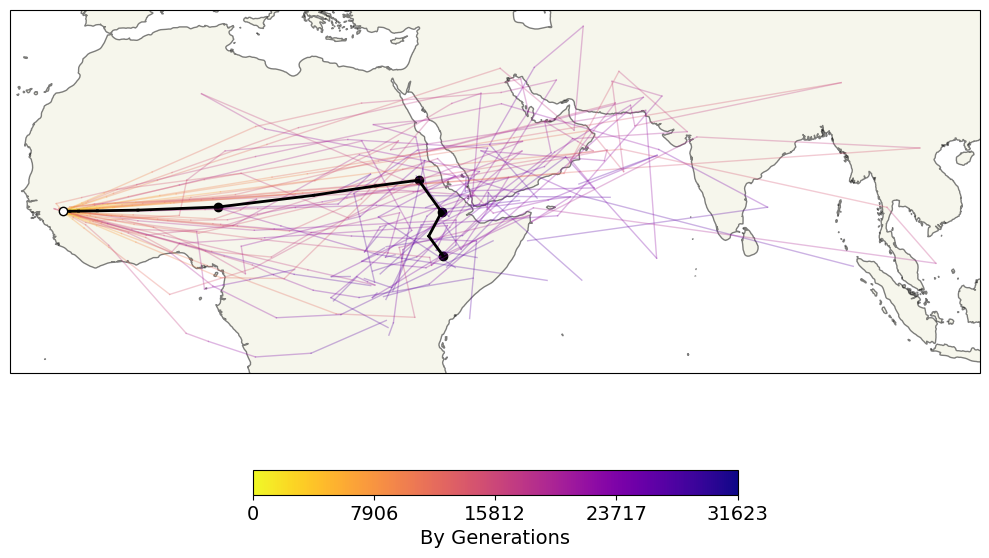

215
2154
4642
31623


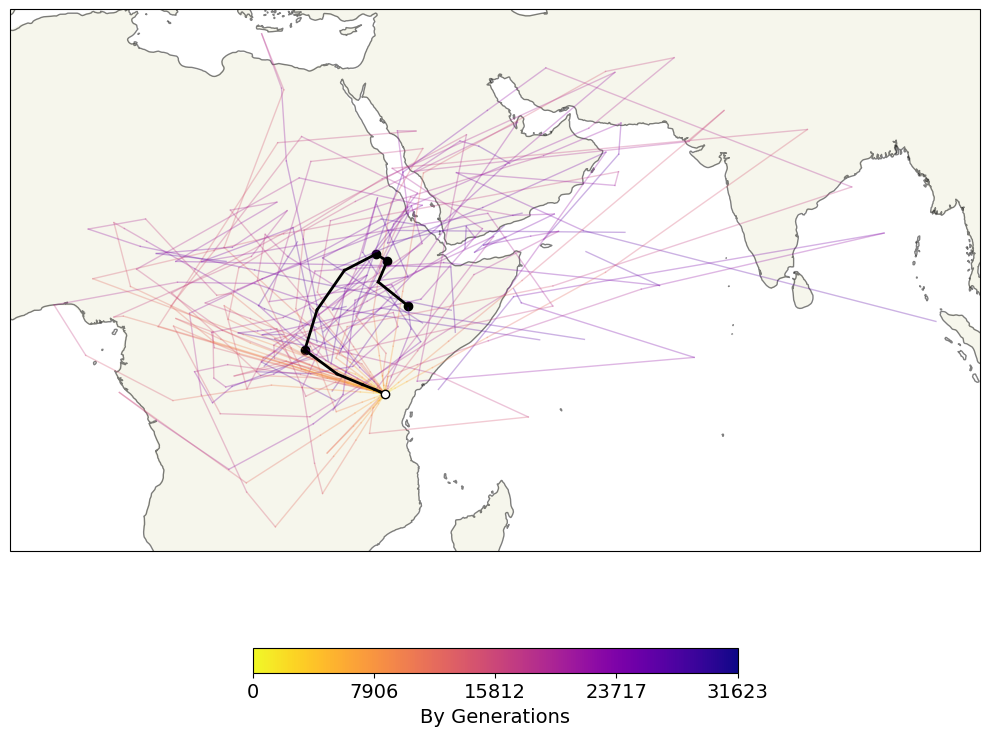

215
2154
4642
31623


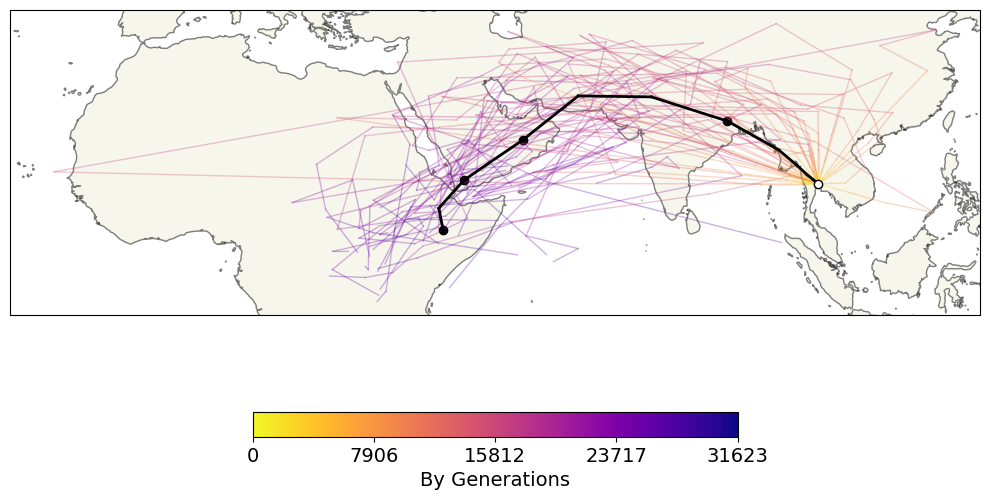

215
2154
4642
31623


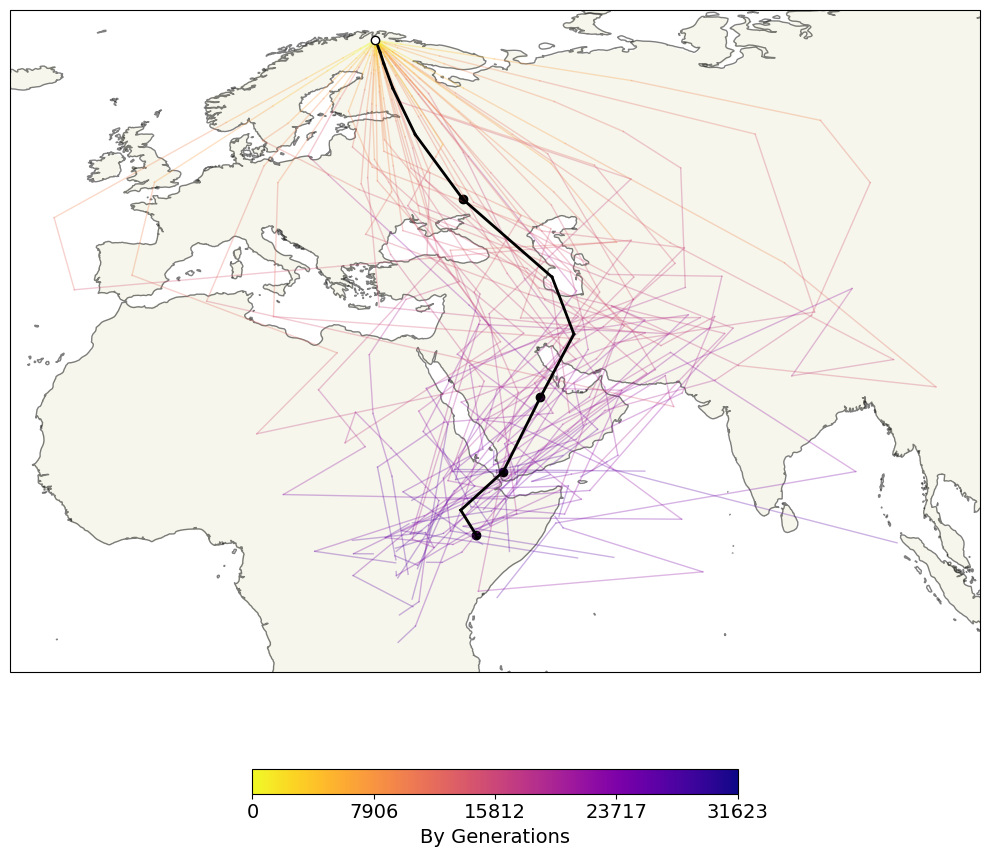

In [209]:
plot_migration_trajectories(locations, ancestor_times, sample_indices=[62,40,236,410])


## gif of all samples by group

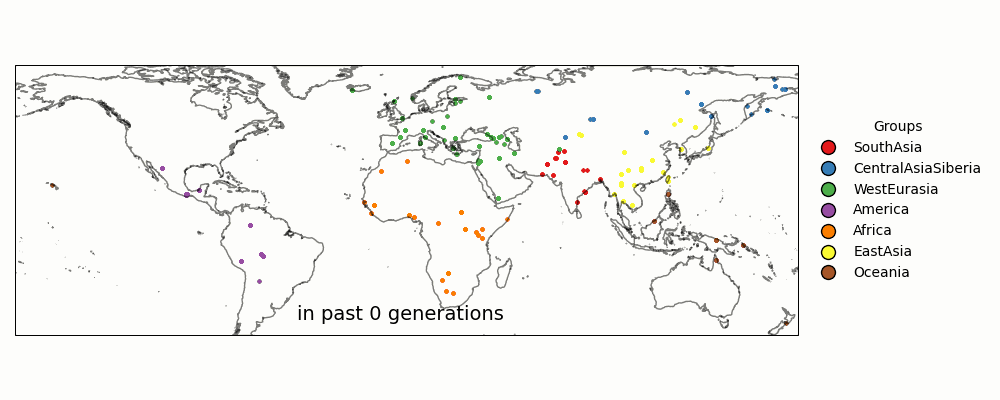

In [21]:
#gif try

def create_gif(ancestor_times, duration):
    frames = []
    for time_ix in range(ancestor_times):
        filename = f'time_ixs_all_group_{time_ix:02d}.png'
        #print(filename)
        frames.append(imageio.v2.imread(os.path.join(plotdir, filename)))
    output_filename='all_group.gif'
    # Create a GIF using imageio
    imageio.mimsave(os.path.join(plotdir, output_filename), frames, duration=duration, loop=0)
    display(Image(filename=os.path.join(plotdir, output_filename)))

# Create the GIF
create_gif(ancestor_times=len(ancestor_times), duration = 100)


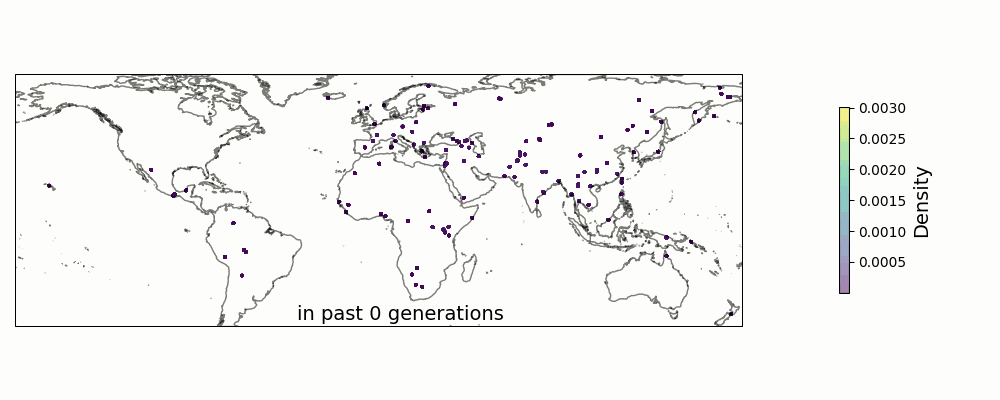

In [150]:
#gif try

def create_gif(ancestor_times, duration):
    frames = []
    for time_ix in range(ancestor_times):
        filename = f'time_ixs_density_{time_ix:02d}.png'
        #print(filename)
        frames.append(imageio.v2.imread(os.path.join(plotdir, filename)))
    output_filename='all_group.gif'
    # Create a GIF using imageio
    imageio.mimsave(os.path.join(plotdir, output_filename), frames, duration=duration, loop=0)
    display(Image(filename=os.path.join(plotdir, output_filename)))

# Create the GIF
create_gif(ancestor_times=len(ancestor_times), duration = 100)


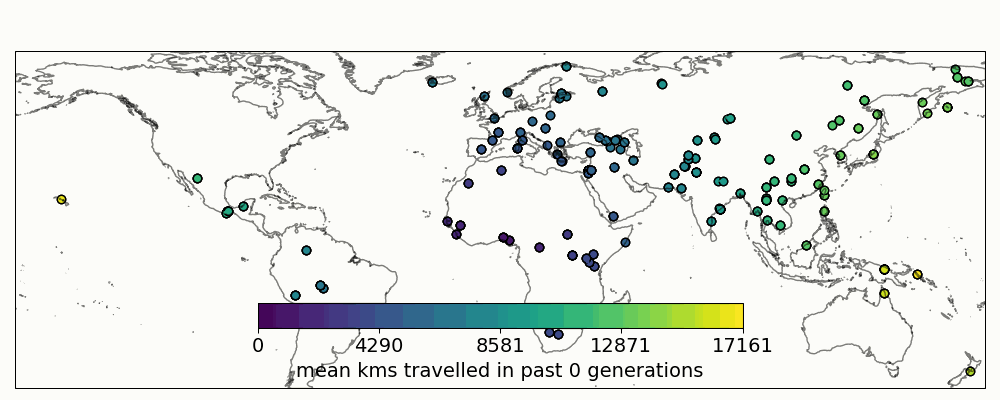

In [59]:
#gif try

def create_gif(num_frames, duration):
    frames = []
    for time_ix in range(num_frames):
        filename = f'time_ixs_{time_ix:02d}.png'
        frames.append(imageio.v2.imread(os.path.join(plotdir, filename)))
    output_filename='mean_displacement.gif'
    # Create a GIF using imageio
    imageio.mimsave(os.path.join(plotdir, output_filename), frames, duration=duration, loop=0)
    display(Image(filename=os.path.join(plotdir, output_filename)))

# Create the GIF
create_gif(num_frames=11, duration = 100)


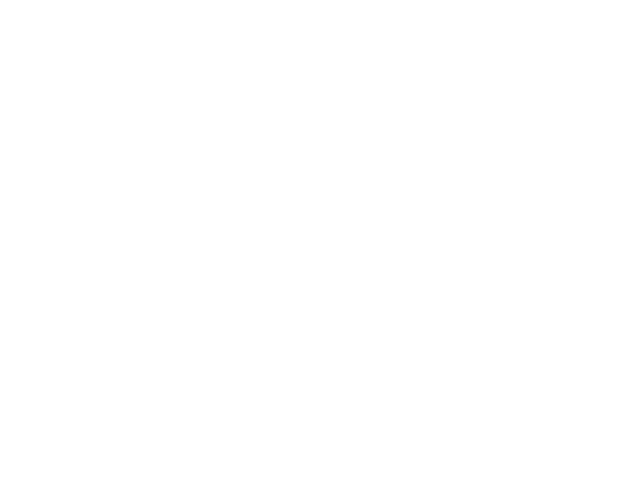

In [152]:
#gif try

def create_gif(num_frames, duration):
    frames = []
    for time_ix in range(num_frames):
        filename = f'time_ixs_all_group_{time_ix:02d}.png'
        frames.append(imageio.v2.imread(os.path.join(plotdir, filename)))
    output_filename='mean_displacement.gif'
    # Create a GIF using imageio
    imageio.mimsave(os.path.join(plotdir, output_filename), frames, duration=duration, loop=0)
    display(Image(filename=os.path.join(plotdir, output_filename)))

# Create the GIF
create_gif(num_frames=11, duration = 100)


## Ancestor clouds

In [125]:
#print(population_ixs)
'''sample = 0
extent=None
time_ixs = range(8,11) #Why 8-11?
levels=10
bw_adjust=1
filename=None'''

def ancestor_clouds(sample, extent=None, time_ixs = range(8,11), 
                    levels=10, bw_adjust=1, filename=None):

    fig, axs = plt.subplots(1,len(time_ixs),figsize=(5*len(time_ixs), 5),
                            subplot_kw={'projection': ccrs.PlateCarree()})
    #Create plots # = len(time_ixs)
    #print(axs)

    print(ids[sample])
    for ax,time_ix in zip(axs,time_ixs):

        print(int(ancestor_times[time_ix]))

        locs = anc_locs[:,sample,time_ix]
    #         row_mask = (locs != locations[sample]).all(axis=1)
    #         locs = locs[row_mask,:] #exclude subtrees that contain only the sample
        #print(locs)

        sns.kdeplot(x=locs[:,0], y=locs[:,1], transform=ccrs.PlateCarree(), 
                    ax=ax, levels=levels, color=plt.cm.tab10(population_ixs[sample]),
                    bw_adjust=bw_adjust, zorder=0)#fill=True, , cmap=cmap
        ax.scatter(locs[:,0], locs[:,1], transform=ccrs.PlateCarree(), 
                   color=plt.cm.tab10(population_ixs[sample]), alpha=0.1)

        ax.scatter(locations[sample,0], locations[sample,1], transform=ccrs.PlateCarree(), 
                   color=plt.cm.tab10(population_ixs[sample]), edgecolor='k')
    #         ax.scatter(locations[:,0], locations[:,1], transform=ccrs.PlateCarree(), color=plt.cm.tab10(population_ixs), alpha=0.1)
        
    #         ax.set_title(int(ancestor_times[time_ix]))
        ax.coastlines(resolution='50m', alpha=0.5)
        ax.add_feature(cfeature.LAND, alpha=0.5)
        if extent is not None:
            ax.set_extent(extent, crs=ccrs.PlateCarree())
    plt.tight_layout()

    if filename is not None:
        plt.savefig(filename)

    plt.show()


## Group cloud

In [151]:
def ancestor_clouds(group_name, extent=None, time_ixs = [5,6,9,11], 
                    levels=10, bw_adjust=1, filename=None):
    
    group_samples = [i for i, name in enumerate(groups) if name == group_name]

    for time_ix in time_ixs:
        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(projection=ccrs.PlateCarree())

        print(int(ancestor_times[time_ix]))
        all_locs = []
        for sample in group_samples:
            locs = anc_locs[:,sample,time_ix]
            all_locs.append(locs)
            ax.scatter(locs[:,0], locs[:,1], transform=ccrs.PlateCarree(), 
                       color=plt.cm.tab10(string_to_number[group_name]), alpha=0.05)
            ax.scatter(locations[sample,0], locations[sample,1], transform=ccrs.PlateCarree(), 
                       color=plt.cm.tab10(string_to_number[group_name]), edgecolor='k')
        all_locs = np.concatenate(all_locs, axis=0)
        sns.kdeplot(x=all_locs[:,0], y=all_locs[:,1], transform=ccrs.PlateCarree(), 
                    ax=ax, levels=levels, color=plt.cm.tab10(string_to_number[group_name]),
                    bw_adjust=bw_adjust, zorder=0,linewidths=0.5)

        ax.coastlines(resolution='50m', alpha=0.5)
        ax.add_feature(cfeature.LAND, alpha=0.5)
        if extent is not None:
            ax.set_extent(extent, crs=ccrs.PlateCarree())
    plt.tight_layout()

    if filename is not None:
        filename.replace('.png', f'time_{time_ix:02d}.png')
    plt.savefig(os.path.join(plotdir, filename))

    plt.show()
    plt.close()



215
464
4642
17783


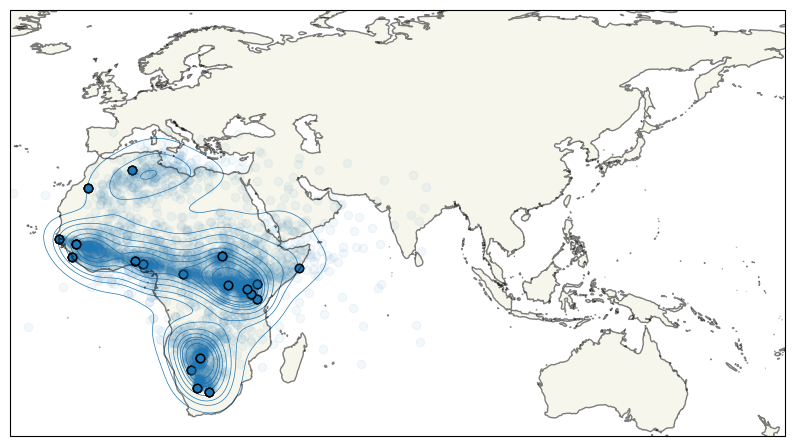

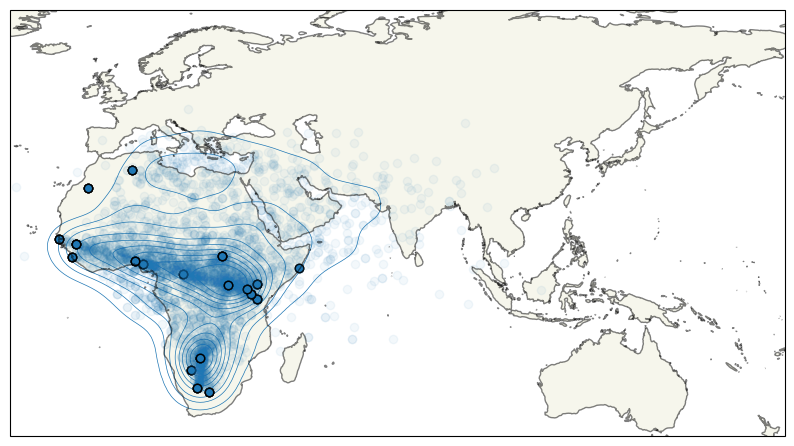

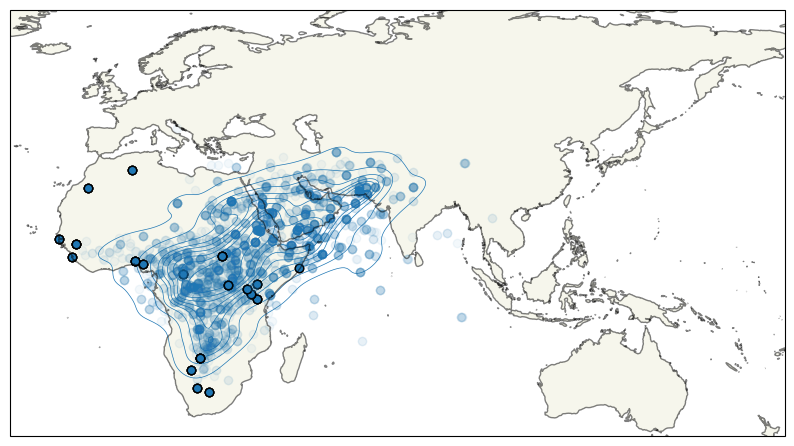

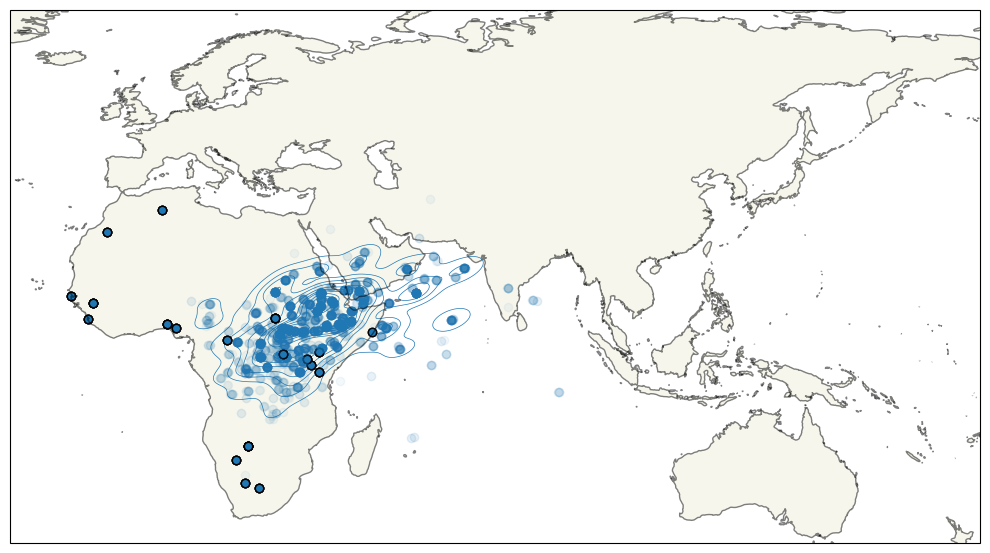

In [152]:
ancestor_clouds('Africa', extent=extent, filename='Africa_clouds.png')

b'S_Luhya-1'
10
46
215
2154
10000


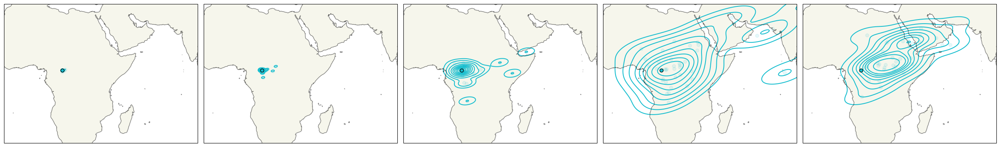

In [49]:
extent = [-10,80,-30,35]
filename = plotdir + 'sample0-cloud.pdf'
# filename = None
ancestor_clouds(19, extent=extent, bw_adjust=0.75, time_ixs = [1,3,5,8,10], filename=filename)

b'S_Naxi-2'
10
46
215
2154
10000


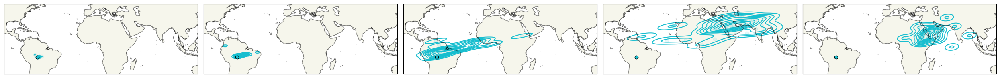

In [55]:
extent = [-100,120,-30,50]
filename = plotdir + 'sample0-cloud.pdf'
# filename = None
ancestor_clouds(80, extent=extent,bw_adjust=0.75, time_ixs = [1,3,5,8,10], filename=filename)

b'S_Dai-2'
10
46
215
2154
10000


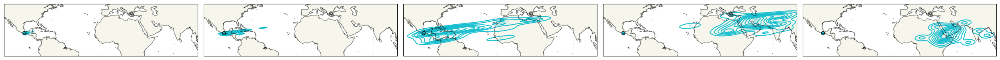

In [41]:
extent = [-120,100,-10,50]
filename = plotdir + 'sample0-cloud.pdf'
# filename = None
ancestor_clouds(100, extent=extent,bw_adjust=0.75, time_ixs = [1,3,5,8,10], filename=filename)

b'S_Estonian-2'
10
46
215
2154
10000


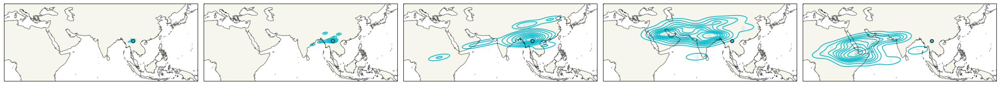

In [45]:
extent = [0,150,-10,50]
filename = plotdir + 'sample0-cloud.pdf'
# filename = None
ancestor_clouds(200, extent=extent,bw_adjust=0.75, time_ixs = [1,3,5,8,10], filename=filename)

b'S_Lezgin-2'
10
46
215
2154
10000


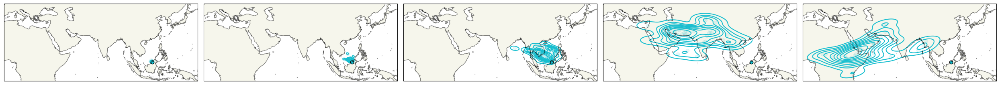

In [46]:
extent = [0,150,-10,50]
filename = plotdir + 'sample0-cloud.pdf'
# filename = None
ancestor_clouds(250, extent=extent,bw_adjust=0.75, time_ixs = [1,3,5,8,10], filename=filename)

1. Locate anc from ARGS
2. 3 previous methods (3 paper)
3. comparing results w/ human data (few slides, gif, plots...)
4. how to share this?

move from scratch
Projects/SGDP/...
original relate data (anc, mut...)
code (snakefile, notebooks, spacetree, utils (py)) - github
dispersal rates
ancestor locations

Todo
1. density/contour of all ancestors (fig 4.)
 --> by groups?
*add null point
2. trajectory of all ancestors of a sample (with superpose mean)


contemporary --> locating ancestors
brownian trees
compare to other methods that exist
2 other key methods 
1. take mean between two ind, and make trees by taking average - naive, just location (no dispersal rate
2. minimizing dispersal cost functions? - hard
both to world-wide human data, we compare our brownian motion method to compare 

variance of all loci Sg,t*sigma
and calculate the 

different projection (cartesian /polar...)

overlapping of CI,
as time going, mean should coalesced, 
看看sqrt(2pi times(vi) ) e^(-sum((x-miui)^2/2vi))